# Introduction:

March 20, 2025

Jonah Zembower, Benjamin Nicholson

Griffin Statistics

This is the submission for the EY 2025 Data Science Challenege where we attempted to assess the Urban Heat Island Effect in New York City. In this project, we placed 86th out of 2076 teams in the world with an accuracy of 0.9606 on the test data. In this notebook, you will see the entire data collection, EDA, feature engineering, and model development that achieved our final model score. 

# Libraries and Data:

Importing necessary libraries:

In [101]:
# Supress Warnings 
import warnings
warnings.filterwarnings('ignore')

# Import common libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import rioxarray as rio
import rasterio
from matplotlib.cm import jet,RdYlGn

# For the geodataframe
import geopandas as gpd
from shapely import wkt
from scipy.spatial import cKDTree
from shapely.ops import nearest_points

# Random forest model libraries:
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.metrics import r2_score
from sklearn.model_selection import RandomizedSearchCV

# Import Planetary Computer tools
import stackstac
import pystac_client
import planetary_computer 
from odc.stac import stac_load

Importing Datasets Provided by EY:

In [102]:
# Load the training data
training_data = pd.read_csv("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\Training_data_uhi_index.csv")
# Load the test data
test_data = pd.read_csv("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\Submission_template.csv")
# Additional Dataset Bronx NY
NY_mesonet_weather_bronx = pd.read_excel("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\NY_Mesonet_Weather.xlsx", sheet_name = 'Bronx')
# Additional Dataset Manhattan NY
NY_mesonet_weather_manhattan = pd.read_excel("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\NY_Mesonet_Weather.xlsx", sheet_name = 'Manhattan')

# Data Collection:

In this section, we are developing the data sources from outside the initial EY data.

### Developing the Data Region:

In [103]:
# The region that is boudning the city into the bronx and manhattan locations
lower_left = (40.75, -74.01)
upper_right = (40.88, -73.86)
# bounds = (min_lon, min_lat, max_lon, max_lat)
bounds = (lower_left[1], lower_left[0], upper_right[1], upper_right[0])

# Define the bounding box
min_lat, min_lon = lower_left
max_lat, max_lon = upper_right

### Datasets:

In [104]:
# Load in the building elevation data
elevation = pd.read_csv('C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\New York Open Source Data\\Building_Elevation_and_Subgrade__BES__20250225.csv')
# Load the planimetric data elevation data
elevation_2 = pd.read_csv("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\Planimetric Database\\NYC_Planimetric_Database__Elevation_Points_20250301.csv")

### Satellite Data:

In [105]:
from pystac_client import Client

# Open a connection to the MPC STAC API
catalog = Client.open("https://planetarycomputer.microsoft.com/api/stac/v1")

# Get all collections from the catalog
collections = catalog.get_collections()

# Extract and print the collection names (IDs)
print("Collection Names in the Microsoft Planetary Computer:")
for collection in collections:
    print(collection.id)

Collection Names in the Microsoft Planetary Computer:
daymet-annual-pr
daymet-daily-hi
3dep-seamless
3dep-lidar-dsm
fia
sentinel-1-rtc
gridmet
daymet-annual-na
daymet-monthly-na
daymet-annual-hi
daymet-monthly-hi
daymet-monthly-pr
gnatsgo-tables
hgb
cop-dem-glo-30
cop-dem-glo-90
goes-cmi
terraclimate
nasa-nex-gddp-cmip6
gpm-imerg-hhr
gnatsgo-rasters
3dep-lidar-hag
io-lulc-annual-v02
conus404
3dep-lidar-intensity
3dep-lidar-pointsourceid
mtbs
noaa-c-cap
3dep-lidar-copc
modis-64A1-061
alos-fnf-mosaic
3dep-lidar-returns
mobi
landsat-c2-l2
era5-pds
chloris-biomass
kaza-hydroforecast
planet-nicfi-analytic
modis-17A2H-061
modis-11A2-061
daymet-daily-pr
3dep-lidar-dtm-native
3dep-lidar-classification
3dep-lidar-dtm
gap
modis-17A2HGF-061
planet-nicfi-visual
gbif
modis-17A3HGF-061
modis-09A1-061
alos-dem
alos-palsar-mosaic
deltares-water-availability
modis-16A3GF-061
modis-21A2-061
us-census
jrc-gsw
deltares-floods
modis-43A4-061
modis-09Q1-061
modis-14A1-061
hrea
modis-13Q1-061
modis-14A2-061


##### Sentinel - 1 Satellite:

In [106]:
# Load the training data
training_data = pd.read_csv("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\Training_data_uhi_index.csv")

In [107]:
# Step 1: Connect to the Planetary Computer STAC API
catalog_url = "https://planetarycomputer.microsoft.com/api/stac/v1"
catalog = pystac_client.Client.open(catalog_url)

# Step 2: Define your search parameters
bbox = [lower_left[1], lower_left[0], upper_right[1], upper_right[0]]
time_range = "2021-05-01/2021-09-01"  # Up to current date, March 14, 2025

search = catalog.search(
    collections=["sentinel-1-grd"],  # Sentinel-1 GRD product
    bbox=bbox,
    datetime=time_range,
    limit=10
)

# Step 3: Retrieve the items
items = list(search.items())
print(f"Found {len(items)} Sentinel-1 scenes.")

Found 10 Sentinel-1 scenes.


In [108]:
signed_items = [planetary_computer.sign(item).to_dict() for item in items]

In [109]:
# Define the pixel resolution for the final product
# Define the scale according to our selected crs, so we will use degrees
resolution = 10  # meters per pixel 
scale = resolution / 111320.0 # degrees per pixel for crs=4326 

In [110]:
# 'items' is a list of STAC Items from a prior search (e.g., via pystac_client)
data = stac_load(
    items,                           # STAC Items from Sentinel-1 GRD search
    bands=["vv", "vh"],             # Sentinel-1 polarization bands
    crs="EPSG:4326",                # Latitude-Longitude coordinate system
    resolution=scale,               # Degrees (set 'scale' to desired resolution, e.g., 0.0001 for ~10 m)
    chunks={"x": 2048, "y": 2048},  # Dask chunks for lazy loading
    dtype="uint16",                 # GRD data typically uint16 (check metadata if float32 needed)
    patch_url=planetary_computer.sign,  # Sign URLs for Planetary Computer access
    bbox=bounds                     # Bounding box in EPSG:4326 [min_lon, min_lat, max_lon, max_lat]
)

In [111]:
# View the dimensions of our XARRAY and the loaded variables
# This insures we have the right coordinates and spectral bands in our xarray
display(data)

<xarray.Dataset> Size: 97MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 10)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 80B 2021-05-03T22:51:29.312261 ... 202...
Data variables:
    vv           (time, latitude, longitude) uint16 48MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    vh           (time, latitude, longitude) uint16 48MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>

Found 10 Sentinel-1 scenes.

Processing scene: S1A_IW_GRDH_1SDV_20210819T225123_20210819T225148_039305_04A43C
Date: 2021-08-19 22:51:35.598873+00:00
Bounding box: [-75.4651838, 40.24374777, -72.17406208, 42.13361755]
Dataset dimensions and variables:


<xarray.Dataset> Size: 10MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 1)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 8B 2021-08-19T22:51:35.598873
Data variables:
    vv           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    vh           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>

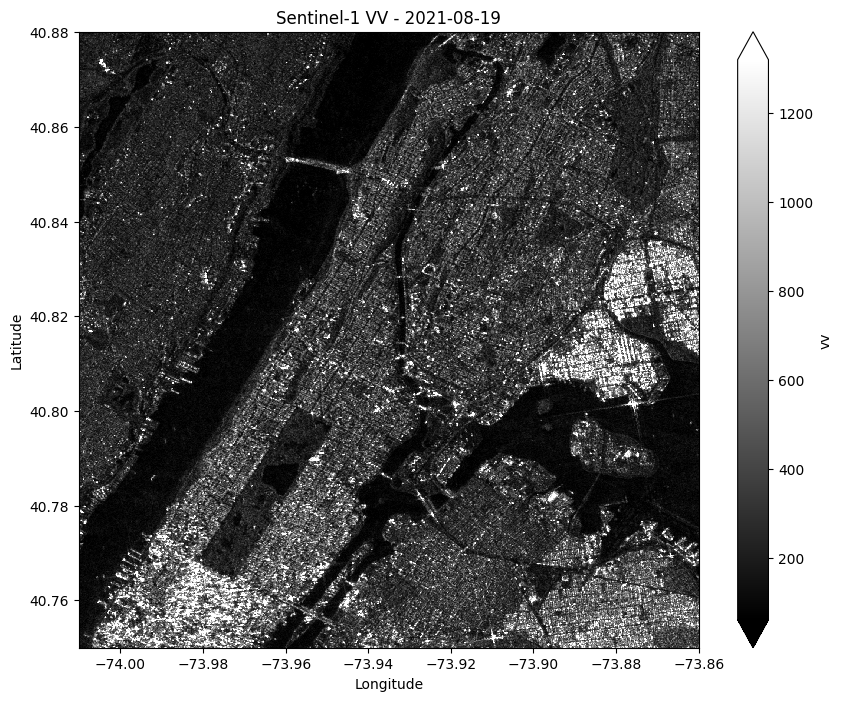

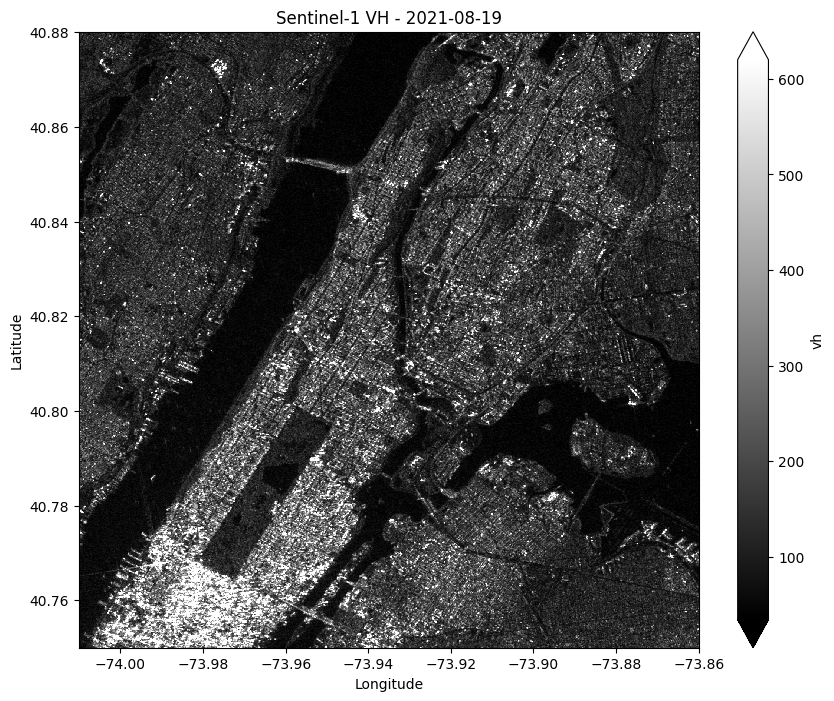


Processing scene: S1A_IW_GRDH_1SDV_20210807T225122_20210807T225147_039130_049E33
Date: 2021-08-07 22:51:35.034500+00:00
Bounding box: [-75.46479893, 40.2437217, -72.17356948, 42.13359489]
Dataset dimensions and variables:


<xarray.Dataset> Size: 10MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 1)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 8B 2021-08-07T22:51:35.034500
Data variables:
    vv           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    vh           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>

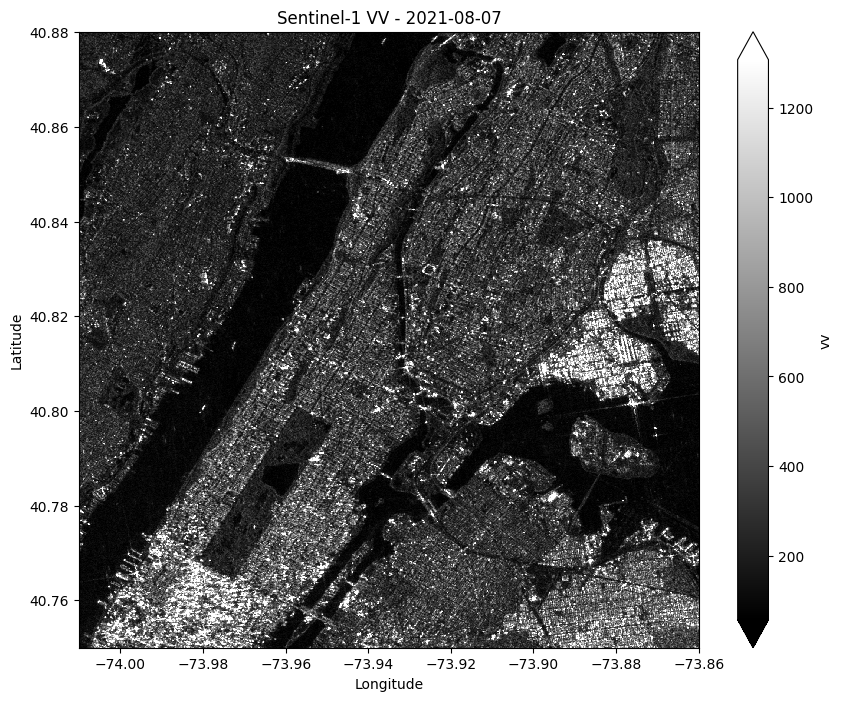

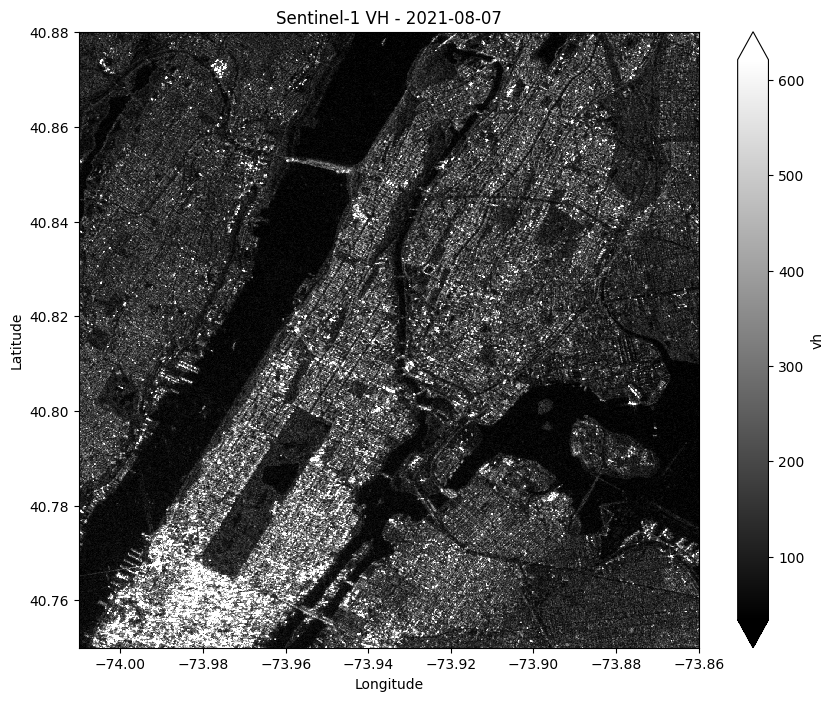


Processing scene: S1A_IW_GRDH_1SDV_20210726T225121_20210726T225146_038955_0498AC
Date: 2021-07-26 22:51:34.205222+00:00
Bounding box: [-75.46443294, 40.24361669, -72.1732776, 42.13363557]
Dataset dimensions and variables:


<xarray.Dataset> Size: 10MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 1)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 8B 2021-07-26T22:51:34.205222
Data variables:
    vv           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    vh           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>

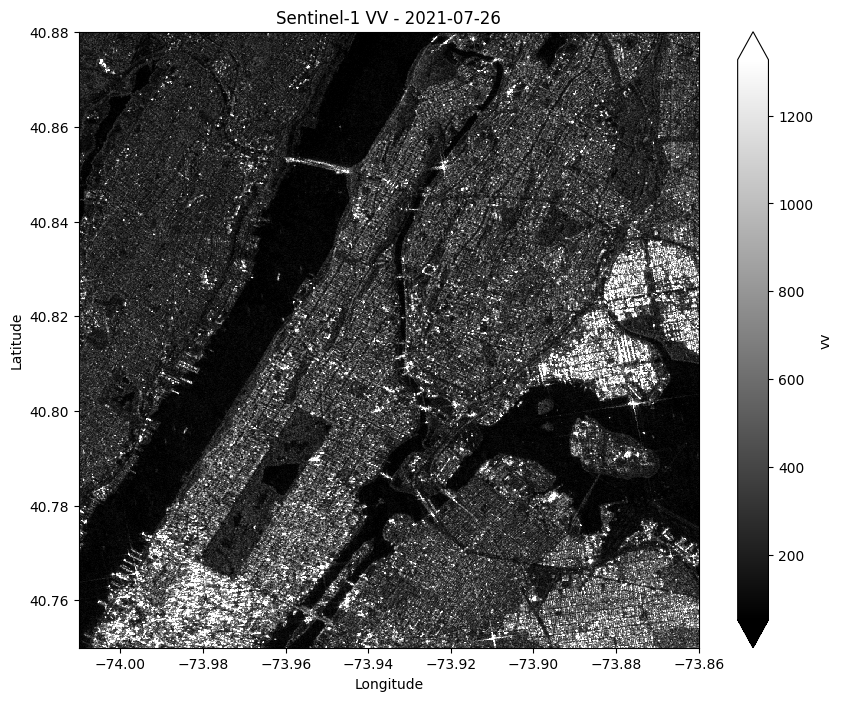

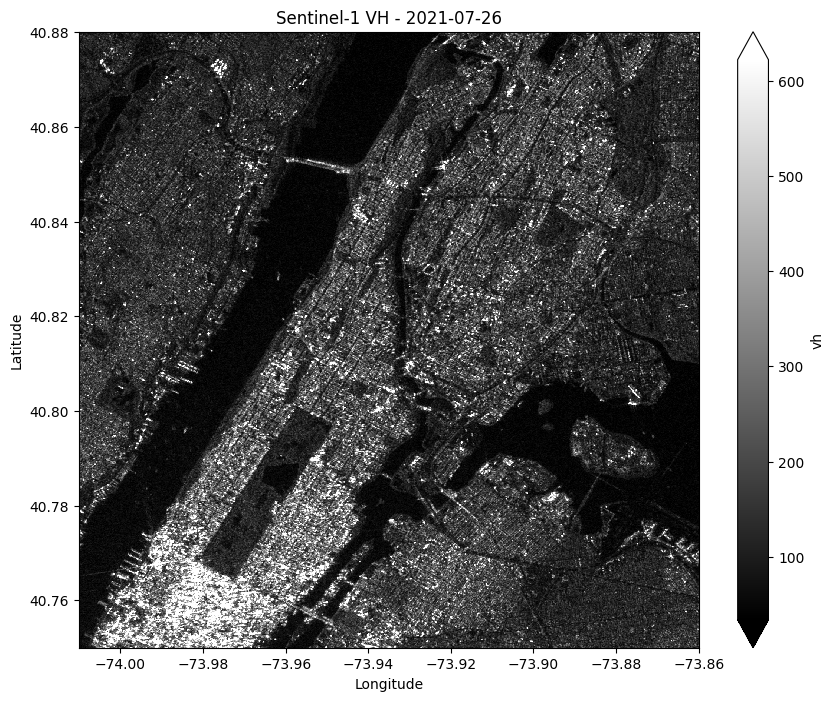


Processing scene: S1A_IW_GRDH_1SDV_20210714T225121_20210714T225146_038780_049371
Date: 2021-07-14 22:51:33.643932+00:00
Bounding box: [-75.46604244, 40.24358637, -72.17479123, 42.13350867]
Dataset dimensions and variables:


<xarray.Dataset> Size: 10MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 1)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 8B 2021-07-14T22:51:33.643932
Data variables:
    vv           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    vh           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>

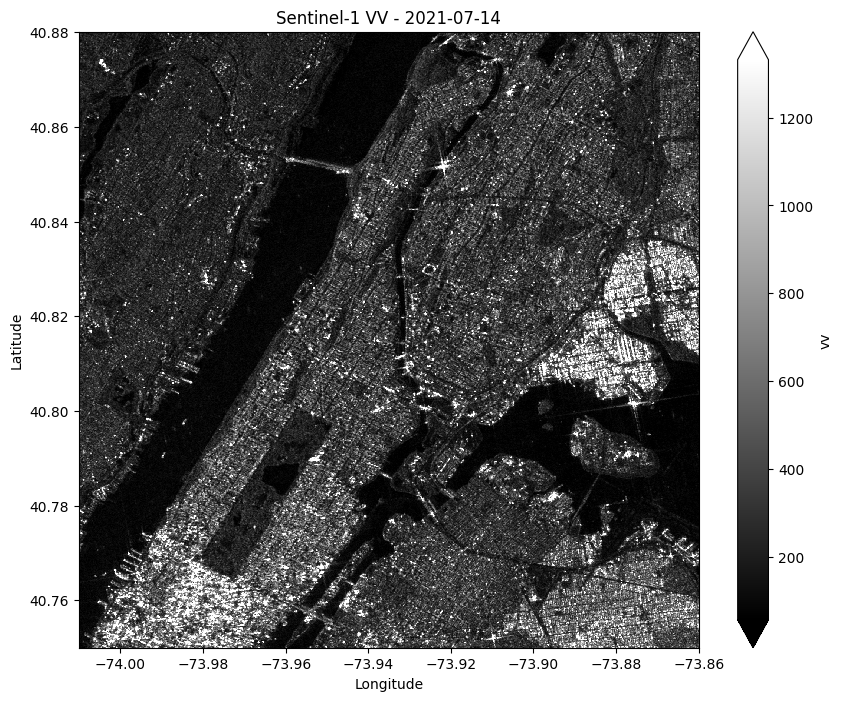

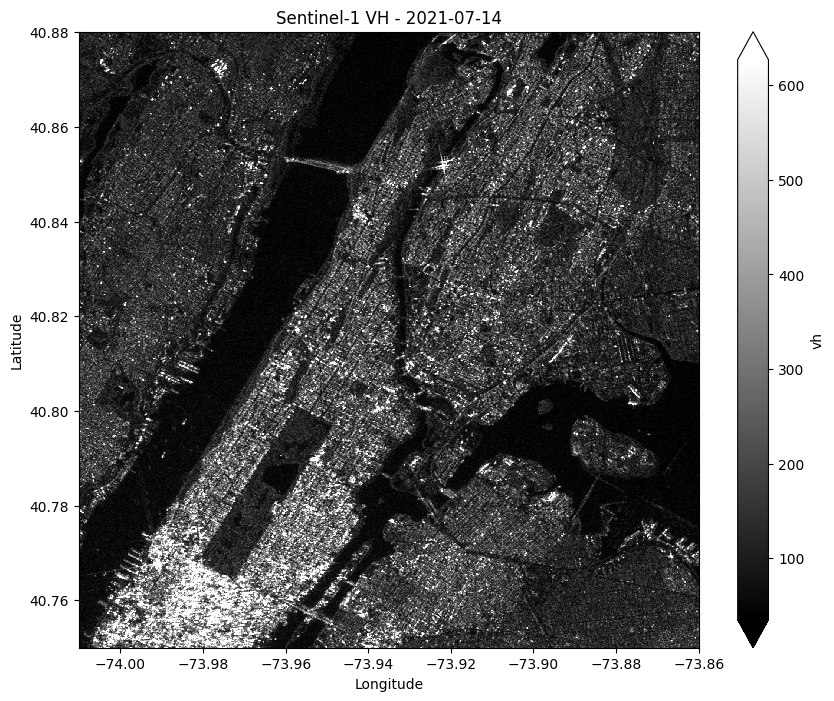


Processing scene: S1A_IW_GRDH_1SDV_20210702T225120_20210702T225145_038605_048E26
Date: 2021-07-02 22:51:32.920987+00:00
Bounding box: [-75.46583113, 40.24360362, -72.17468861, 42.13351088]
Dataset dimensions and variables:


<xarray.Dataset> Size: 10MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 1)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 8B 2021-07-02T22:51:32.920987
Data variables:
    vv           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    vh           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>

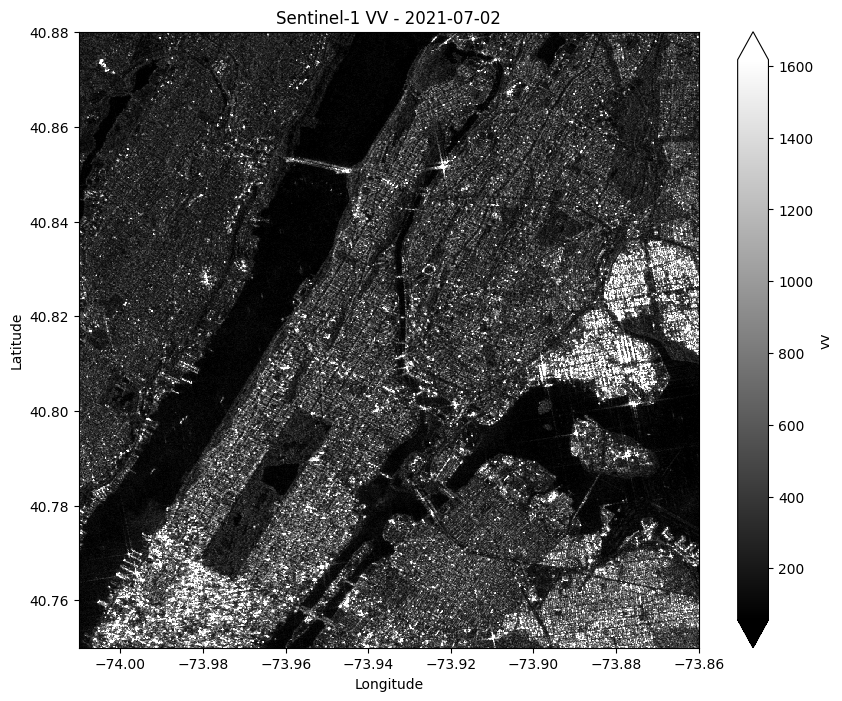

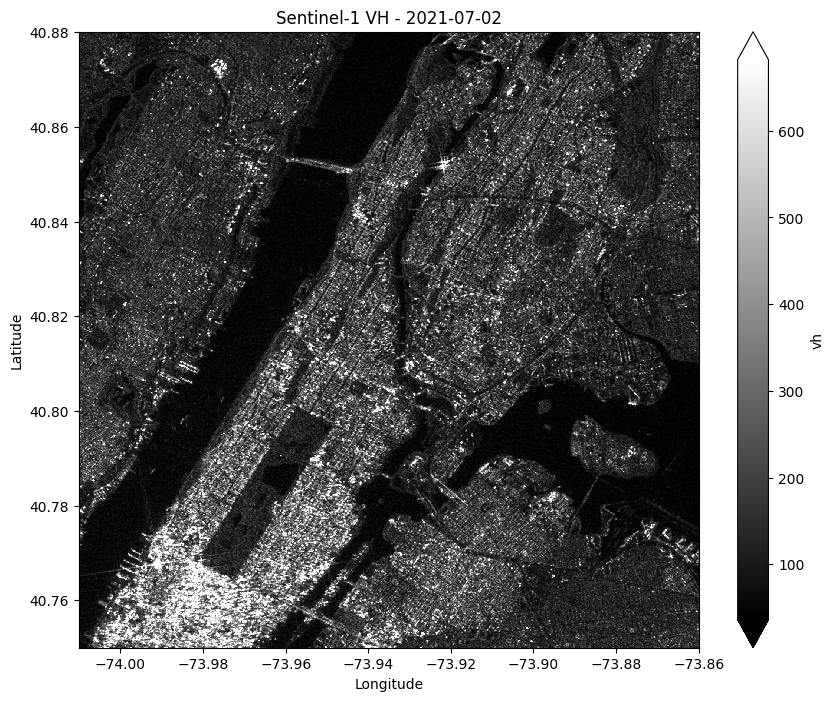


Processing scene: S1A_IW_GRDH_1SDV_20210620T225119_20210620T225144_038430_0488EA
Date: 2021-06-20 22:51:32.186233+00:00
Bounding box: [-75.46613087, 40.24345067, -72.17474864, 42.13347108]
Dataset dimensions and variables:


<xarray.Dataset> Size: 10MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 1)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 8B 2021-06-20T22:51:32.186233
Data variables:
    vv           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    vh           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>

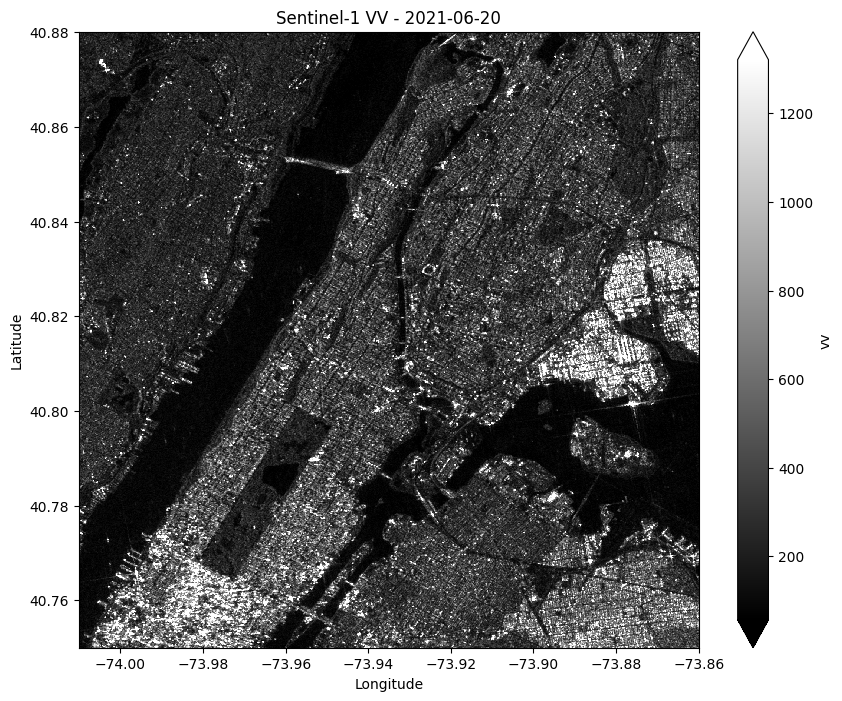

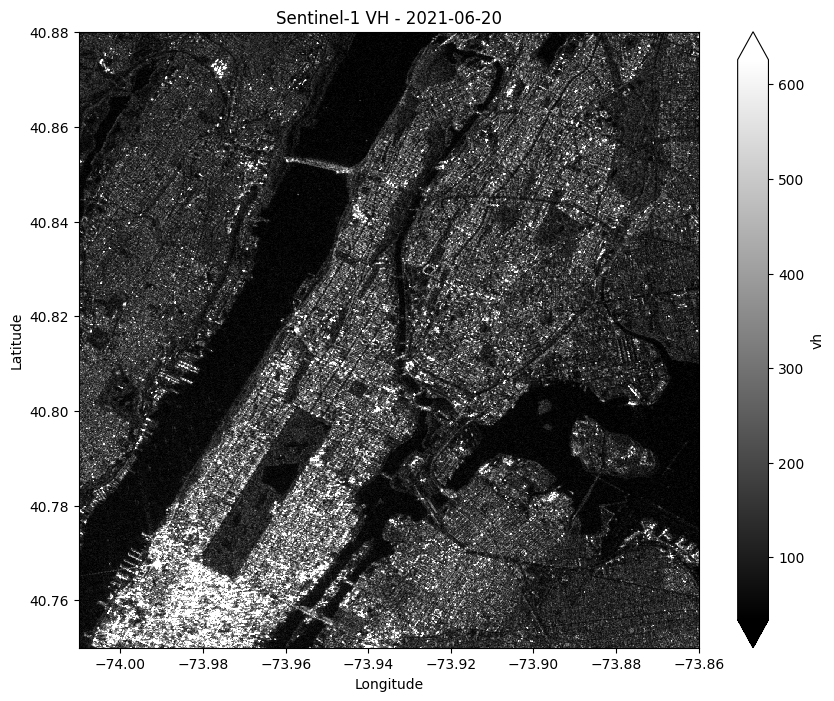


Processing scene: S1A_IW_GRDH_1SDV_20210608T225118_20210608T225143_038255_0483B4
Date: 2021-06-08 22:51:31.423016+00:00
Bounding box: [-75.46536012, 40.24359273, -72.17423715, 42.1334686]
Dataset dimensions and variables:


<xarray.Dataset> Size: 10MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 1)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 8B 2021-06-08T22:51:31.423016
Data variables:
    vv           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    vh           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>

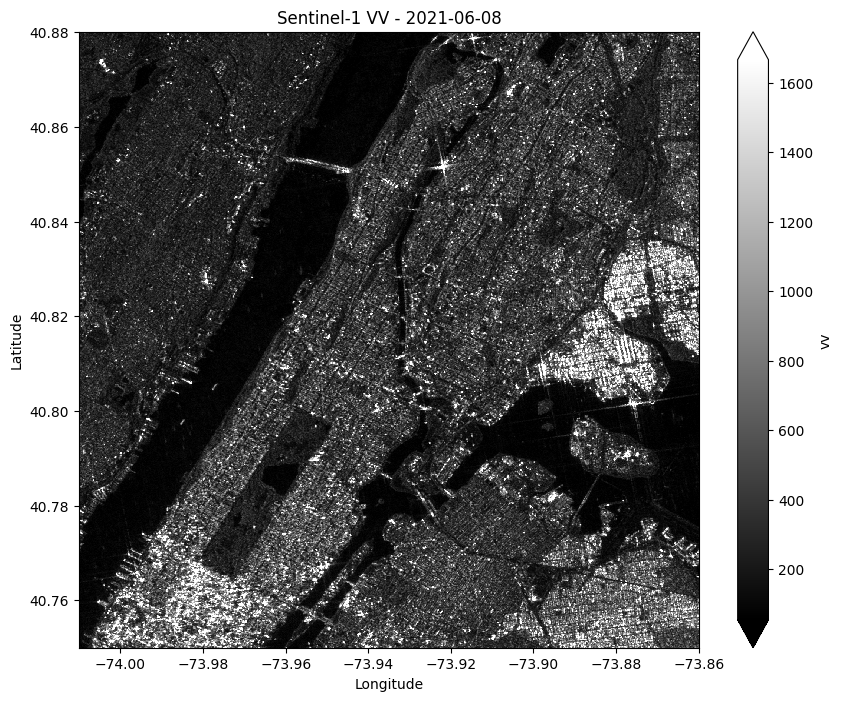

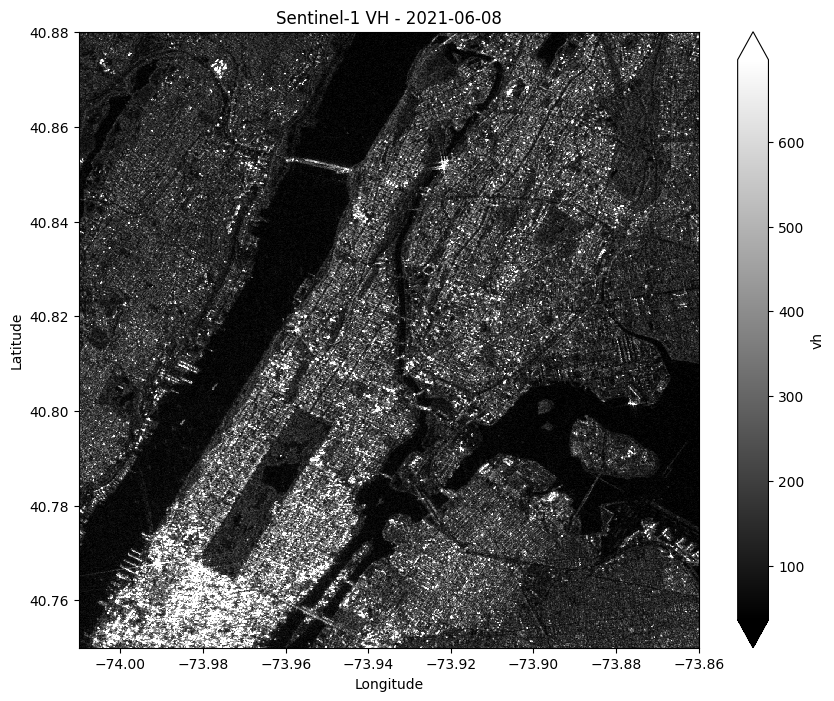


Processing scene: S1A_IW_GRDH_1SDV_20210527T225118_20210527T225143_038080_047E81
Date: 2021-05-27 22:51:30.712569+00:00
Bounding box: [-75.46486117, 40.24360186, -72.17375142, 42.1334632]
Dataset dimensions and variables:


<xarray.Dataset> Size: 10MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 1)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 8B 2021-05-27T22:51:30.712569
Data variables:
    vv           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    vh           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>

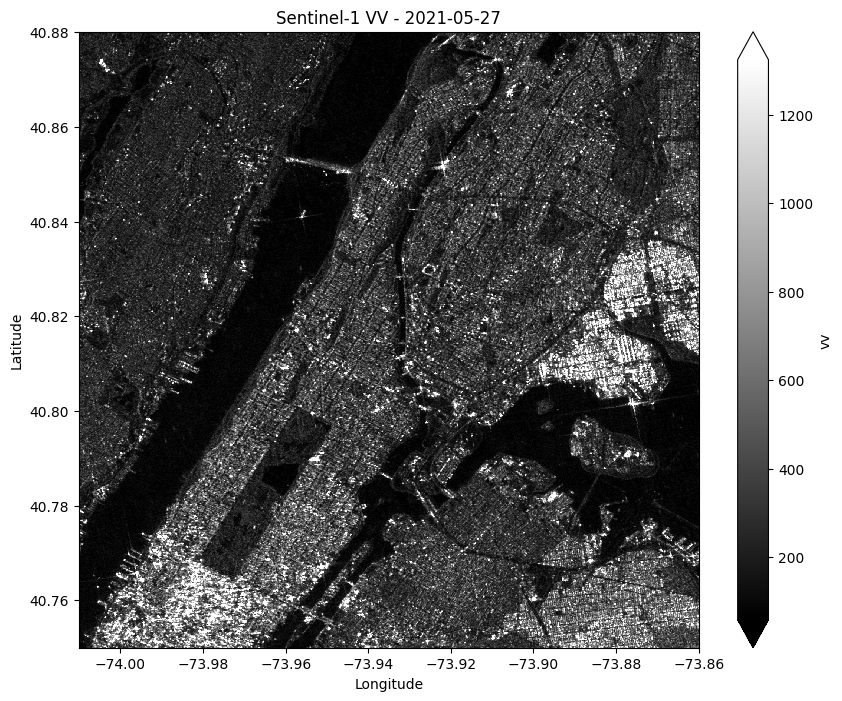

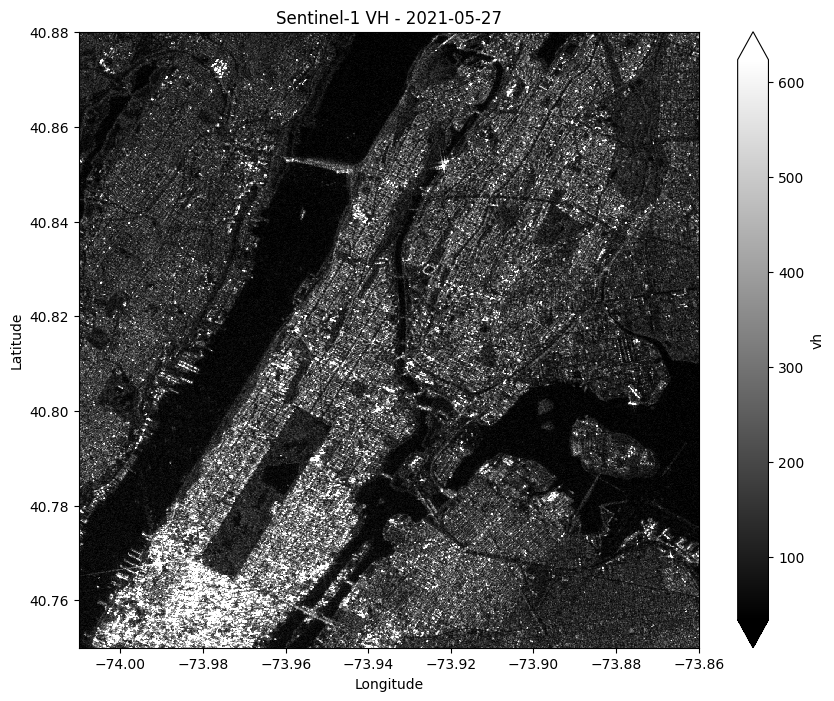


Processing scene: S1A_IW_GRDH_1SDV_20210515T225117_20210515T225142_037905_047938
Date: 2021-05-15 22:51:29.961255+00:00
Bounding box: [-75.46525352, 40.24352316, -72.17401553, 42.13342779]
Dataset dimensions and variables:


<xarray.Dataset> Size: 10MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 1)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 8B 2021-05-15T22:51:29.961255
Data variables:
    vv           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    vh           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>

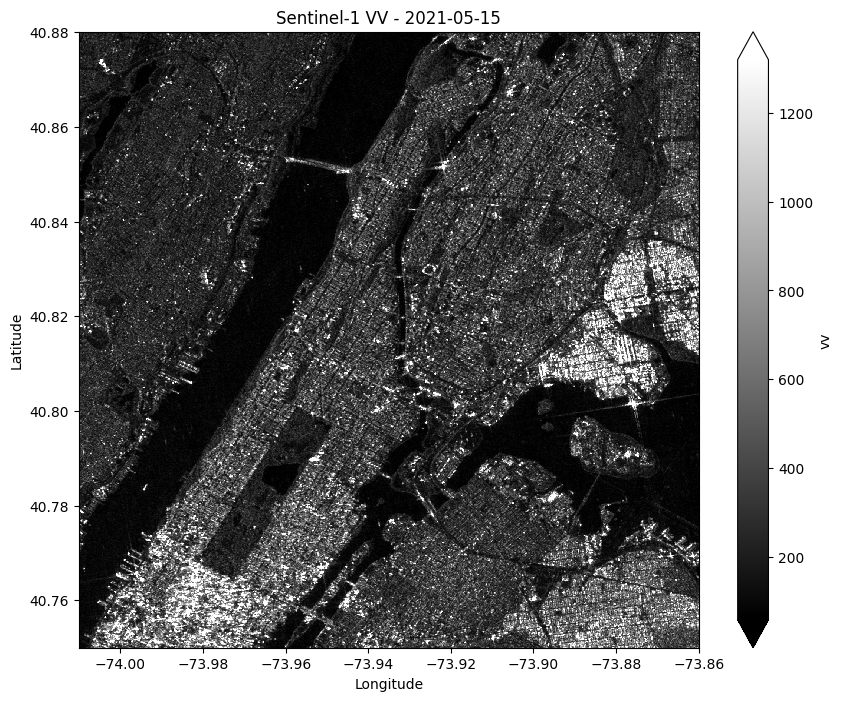

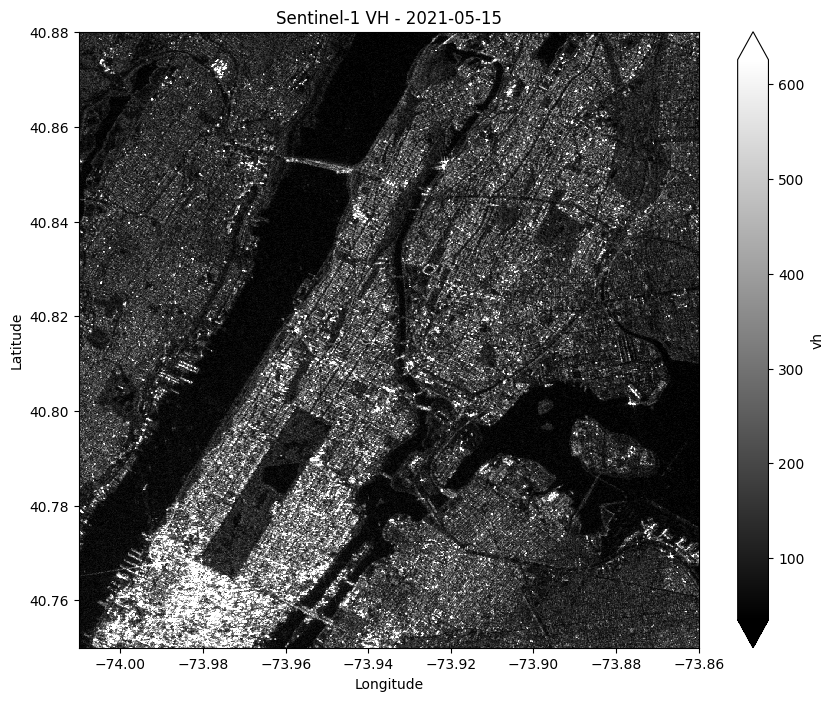


Processing scene: S1A_IW_GRDH_1SDV_20210503T225116_20210503T225141_037730_0473E6
Date: 2021-05-03 22:51:29.312261+00:00
Bounding box: [-75.4648745, 40.24348853, -72.17375097, 42.13338906]
Dataset dimensions and variables:


<xarray.Dataset> Size: 10MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 1)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 8B 2021-05-03T22:51:29.312261
Data variables:
    vv           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    vh           (time, latitude, longitude) uint16 5MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>

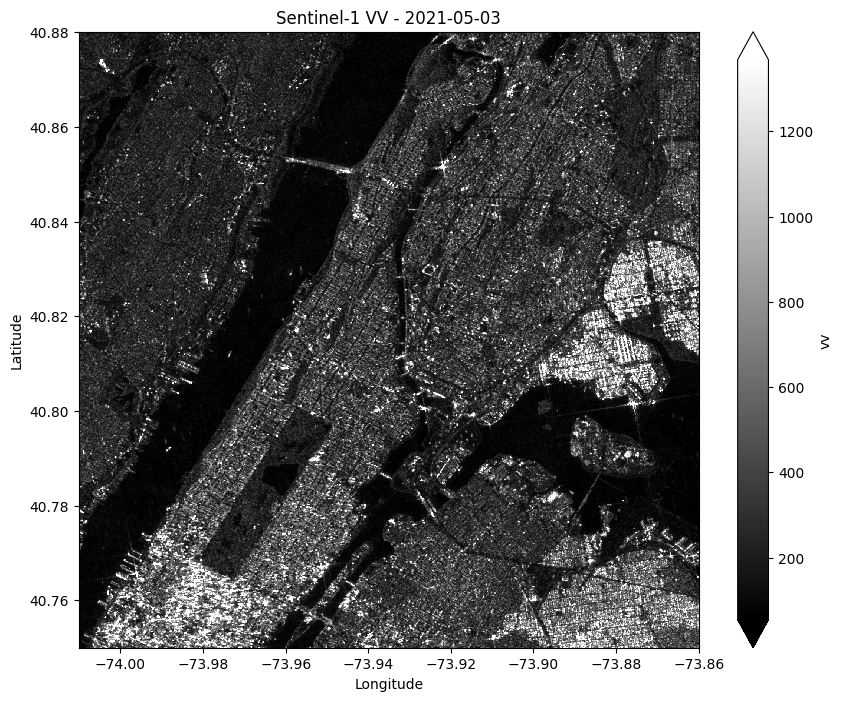

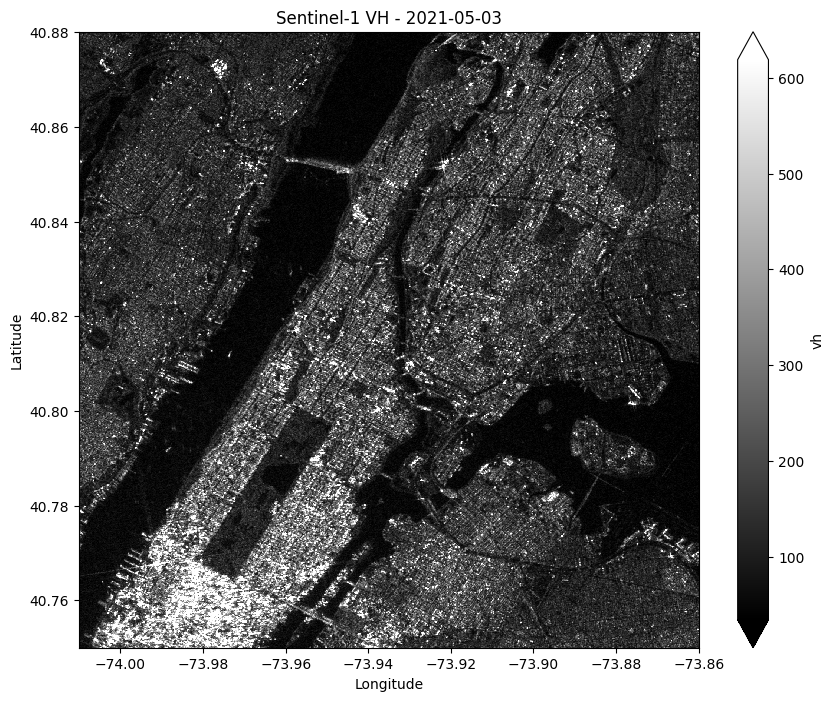

In [112]:
# Step 3: Retrieve the items
items = list(search.items())
print(f"Found {len(items)} Sentinel-1 scenes.")

if not items:
    print("No scenes found. Check bbox or time_range.")
else:
    # Define resolution and scale
    resolution = 10  # meters per pixel
    scale = resolution / 111320.0  # degrees per pixel for EPSG:4326

    # Use bbox as bounds (assuming this is what you meant by 'bounds')
    bounds = bbox

    # Step 4: Process and output each scene individually
    for item in items:
        print(f"\nProcessing scene: {item.id}")
        print(f"Date: {item.datetime}")
        print(f"Bounding box: {item.bbox}")  # Fixed: Removed parentheses

        # Load this single scene
        data = stac_load(
            [item],  # Pass single item as a list
            bands=["vv", "vh"],
            crs="EPSG:4326",
            resolution=scale,
            chunks={"longiude": 2048, "latitude": 2048},
            dtype="uint16",
            patch_url=planetary_computer.sign,
            bbox=bounds
        )

        # Display dataset info
        print("Dataset dimensions and variables:")
        display(data)

        # Plot VV band (non-interactive with matplotlib)
        plt.figure(figsize=(10, 8))
        data["vv"].plot(robust=True, cmap="gray")
        plt.title(f"Sentinel-1 VV - {item.datetime.date()}")
        plt.xlabel("Longitude")
        plt.ylabel("Latitude")
        plt.show()

        # Plot VH band
        plt.figure(figsize=(10, 8))
        data["vh"].plot(robust=True, cmap="gray")
        plt.title(f"Sentinel-1 VH - {item.datetime.date()}")
        plt.xlabel("Longitude")
        plt.ylabel("Latitude")
        plt.show()

In [113]:
filename = "S1_bands_July_26_2021.tiff"

In [114]:
# Find the scene with the date July 26, 2021
scene_date = "2021-07-26"
selected_scene = None

for item in items:
    if item.datetime.date().isoformat() == scene_date:
        selected_scene = item
        break

if selected_scene:
    print(f"Selected scene ID: {selected_scene.id}")
else:
    print("Scene with the specified date not found.")

Selected scene ID: S1A_IW_GRDH_1SDV_20210726T225121_20210726T225146_038955_0498AC


In [115]:
# Load the data for the selected scene
selected_data = stac_load(
    [selected_scene],  # Pass the selected scene as a list
    bands=["vv", "vh"],
    crs="EPSG:4326",
    resolution=scale,
    chunks={"longitude": 2048, "latitude": 2048},
    dtype="uint16",
    patch_url=planetary_computer.sign,
    bbox=bounds
)

# Extract the data slice for the selected scene
data_slice = selected_data.isel(time=0)

# Display the data slice
display(data_slice)

<xarray.Dataset> Size: 10MB
Dimensions:      (latitude: 1448, longitude: 1671)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
    time         datetime64[ns] 8B 2021-07-26T22:51:34.205222
Data variables:
    vv           (latitude, longitude) uint16 5MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>
    vh           (latitude, longitude) uint16 5MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>

In [116]:
# Calculate the dimensions of the file
# height = median.dims["latitude"]
# width = median.dims["longitude"]
height = data_slice.dims["latitude"]
width = data_slice.dims["longitude"]

In [117]:
# Define the Coordinate Reference System (CRS) to be common Lat-Lon coordinates
# Define the tranformation using our bounding box so the Lat-Lon information is written to the GeoTIFF
gt = rasterio.transform.from_bounds(lower_left[1],lower_left[0],upper_right[1],upper_right[0],width,height)
data_slice.rio.write_crs("epsg:4326", inplace=True)
data_slice.rio.write_transform(transform=gt, inplace=True)

<xarray.Dataset> Size: 10MB
Dimensions:      (latitude: 1448, longitude: 1671)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    time         datetime64[ns] 8B 2021-07-26T22:51:34.205222
    spatial_ref  int64 8B 0
Data variables:
    vv           (latitude, longitude) uint16 5MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>
    vh           (latitude, longitude) uint16 5MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>

In [118]:
# Create the GeoTIFF output file using the defined parameters 
with rasterio.open(filename, 'w', driver='GTiff', width=width, height=height,
                   crs='epsg:4326', transform=gt, count=2, compress='lzw', dtype='uint16') as dst:
    dst.write(data_slice.vv, 1)
    dst.write(data_slice.vh, 2)
    dst.close()

In [119]:
# Open the GeoTIFF file
with rasterio.open('S1_bands_July_26_2021.tiff') as src:
    # Read the data
    lst_data = src.read(1)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform

# Function to get the value for a given longitude and latitude
def get_lst_value(lon, lat):
    row, col = ~transform * (lon, lat)
    row, col = int(row), int(col)
    # Ensure the indices are within bounds
    if 0 <= row < lst_data.shape[0] and 0 <= col < lst_data.shape[1]:
        return lst_data[row, col]
    else:
        return None

# Add the LST values to the training data
training_data['vv'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

# Open the GeoTIFF file
with rasterio.open('S1_bands_July_26_2021.tiff') as src:
    # Read the data
    lst_data = src.read(2)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform

# Add the LST values to the training data
training_data['vh'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

In [120]:
training_data.to_csv("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\Sentinel_1_All_Bands_July_26_2021.csv", index=False)

##### Sentinel - 2 Satellite:

In [121]:
# Load the training data
training_data = pd.read_csv("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\Training_data_uhi_index.csv")

In [122]:
# Define the time window
time_window = "2021-05-01/2021-09-01"

In [123]:
stac = pystac_client.Client.open("https://planetarycomputer.microsoft.com/api/stac/v1")

search = stac.search(
    bbox=bounds, 
    datetime=time_window,
    collections=["sentinel-2-l2a"],
    query={"eo:cloud_cover": {"lt": 30}},
)

In [124]:
items = list(search.get_items())
print('This is the number of scenes that touch our region:',len(items))

This is the number of scenes that touch our region: 16


In [125]:
signed_items = [planetary_computer.sign(item).to_dict() for item in items]

In [126]:
# Define the pixel resolution for the final product
# Define the scale according to our selected crs, so we will use degrees
resolution = 10  # meters per pixel 
scale = resolution / 111320.0 # degrees per pixel for crs=4326 

In [127]:
data = stac_load(
    items,
    bands=["B01", "B02", "B03", "B04", "B05", "B06", "B07", "B08", "B8A", "B11", "B12"],
    crs="EPSG:4326", # Latitude-Longitude
    resolution=scale, # Degrees
    chunks={"x": 2048, "y": 2048},
    dtype="uint16",
    patch_url=planetary_computer.sign,
    bbox=bounds
)

In [128]:
# View the dimensions of our XARRAY and the loaded variables
# This insures we have the right coordinates and spectral bands in our xarray
display(data)

<xarray.Dataset> Size: 852MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 16)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 128B 2021-05-12T15:39:11.024000 ... 20...
Data variables:
    B01          (time, latitude, longitude) uint16 77MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    B02          (time, latitude, longitude) uint16 77MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    B03          (time, latitude, longitude) uint16 77MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    B04          (time, latitude, longitude) uint16 77MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    B05          (time, latitude, longitude) uint16 77MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    B06          (time, latitude, longitude) uint16 77MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    B07          (time, latitude, longitude) uint16 77MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    B08          (time, latitude, longitude) uint16 77MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    B8A          (time, latitude, longitude) uint16 77MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    B11          (time, latitude, longitude) uint16 77MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    B12          (time, latitude, longitude) uint16 77MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>

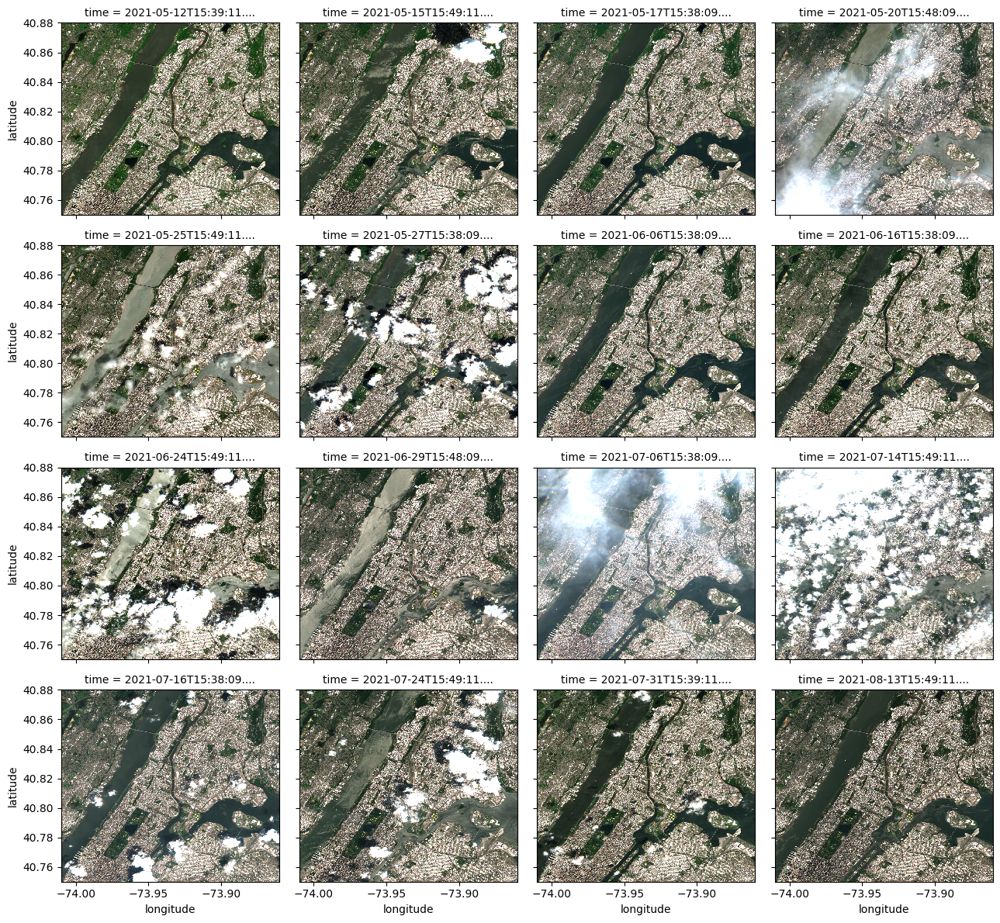

In [129]:
# Plot sample images from the time series
plot_data = data[["B04","B03","B02"]].to_array()
plot_data.plot.imshow(col='time', col_wrap=4, robust=True, vmin=0, vmax=2500)
plt.show()

In [130]:
# Select the scene that best mathces the weather for the day. I select, May 17
scene = 2

In [131]:
filename = "S2_bands.tiff"

In [132]:
# We will pick a single time slice from the time series (time=7) 
# This time slice is the date of May 17, 2021
data_slice = data.isel(time=scene)

In [133]:
# Calculate the dimensions of the file
# height = median.dims["latitude"]
# width = median.dims["longitude"]
height = data_slice.dims["latitude"]
width = data_slice.dims["longitude"]

In [134]:
# Define the Coordinate Reference System (CRS) to be common Lat-Lon coordinates
# Define the tranformation using our bounding box so the Lat-Lon information is written to the GeoTIFF
gt = rasterio.transform.from_bounds(lower_left[1],lower_left[0],upper_right[1],upper_right[0],width,height)
data_slice.rio.write_crs("epsg:4326", inplace=True)
data_slice.rio.write_transform(transform=gt, inplace=True)

<xarray.Dataset> Size: 53MB
Dimensions:      (latitude: 1448, longitude: 1671)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    time         datetime64[ns] 8B 2021-05-17T15:38:09.024000
    spatial_ref  int64 8B 0
Data variables:
    B01          (latitude, longitude) uint16 5MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>
    B02          (latitude, longitude) uint16 5MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>
    B03          (latitude, longitude) uint16 5MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>
    B04          (latitude, longitude) uint16 5MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>
    B05          (latitude, longitude) uint16 5MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>
    B06          (latitude, longitude) uint16 5MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>
    B07          (latitude, longitude) uint16 5MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>
    B08          (latitude, longitude) uint16 5MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>
    B8A          (latitude, longitude) uint16 5MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>
    B11          (latitude, longitude) uint16 5MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>
    B12          (latitude, longitude) uint16 5MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>

In [135]:
# Create the GeoTIFF output file using the defined parameters 
with rasterio.open(filename,'w',driver='GTiff',width=width,height=height,
                   crs='epsg:4326',transform=gt,count=11,compress='lzw',dtype='float64') as dst:
    dst.write(data_slice.B01,1)
    dst.write(data_slice.B02,2)
    dst.write(data_slice.B03,3)
    dst.write(data_slice.B04,4)
    dst.write(data_slice.B05,5)
    dst.write(data_slice.B06,6)
    dst.write(data_slice.B07,7)
    dst.write(data_slice.B08,8)
    dst.write(data_slice.B8A,9)
    dst.write(data_slice.B11,10)
    dst.write(data_slice.B12,11)
    dst.close()

In [136]:
# Open the GeoTIFF file
with rasterio.open('S2_bands.tiff') as src:
    # Read the data
    lst_data = src.read(1)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform

# Function to get the value for a given longitude and latitude
def get_lst_value(lon, lat):
    row, col = ~transform * (lon, lat)
    row, col = int(row), int(col)
    # Ensure the indices are within bounds
    if 0 <= row < lst_data.shape[0] and 0 <= col < lst_data.shape[1]:
        return lst_data[row, col]
    else:
        return None

# Add the LST values to the training data
training_data['B01'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

# Open the GeoTIFF file
with rasterio.open('S2_bands.tiff') as src:
    # Read the data
    lst_data = src.read(2)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform
# Add the LST values to the training data
training_data['B02'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

# Open the GeoTIFF file
with rasterio.open('S2_bands.tiff') as src:
    # Read the data
    lst_data = src.read(3)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform
# Add the LST values to the training data
training_data['B03'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

# Open the GeoTIFF file
with rasterio.open('S2_bands.tiff') as src:
    # Read the data
    lst_data = src.read(4)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform
# Add the LST values to the training data
training_data['B04'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

# Open the GeoTIFF file
with rasterio.open('S2_bands.tiff') as src:
    # Read the data
    lst_data = src.read(5)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform
# Add the LST values to the training data
training_data['B05'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

# Open the GeoTIFF file
with rasterio.open('S2_bands.tiff') as src:
    # Read the data
    lst_data = src.read(6)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform
# Add the LST values to the training data
training_data['B06'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

# Open the GeoTIFF file
with rasterio.open('S2_bands.tiff') as src:
    # Read the data
    lst_data = src.read(7)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform
# Add the LST values to the training data
training_data['B07'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

# Open the GeoTIFF file
with rasterio.open('S2_bands.tiff') as src:
    # Read the data
    lst_data = src.read(8)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform
# Add the LST values to the training data
training_data['B08'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

# Open the GeoTIFF file
with rasterio.open('S2_bands.tiff') as src:
    # Read the data
    lst_data = src.read(9)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform
# Add the LST values to the training data
training_data['B8A'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

# Open the GeoTIFF file
with rasterio.open('S2_bands.tiff') as src:
    # Read the data
    lst_data = src.read(10)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform
# Add the LST values to the training data
training_data['B11'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

# Open the GeoTIFF file
with rasterio.open('S2_bands.tiff') as src:
    # Read the data
    lst_data = src.read(11)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform
# Add the LST values to the training data
training_data['B12'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

In [137]:
training_data.to_csv("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\Sentinel_2_All_Bands_May_17_2021.csv", index=False)

##### Landsat - 8 Satellite:

In [138]:
# Load the training data
training_data = pd.read_csv("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\Training_data_uhi_index.csv")

In [139]:
# Define the time window
# We will use the training data day to search for data
time_window = "2021-05-01/2021-08-31"

In [140]:
stac = pystac_client.Client.open("https://planetarycomputer.microsoft.com/api/stac/v1")

search = stac.search(
    bbox=bounds, 
    datetime=time_window,
    collections=["landsat-c2-l2"],
    query={"eo:cloud_cover": {"lt": 50},"platform": {"in": ["landsat-8"]}},
)

In [141]:
items = list(search.get_items())
print('This is the number of scenes that touch our region:',len(items))

This is the number of scenes that touch our region: 11


In [142]:
signed_items = [planetary_computer.sign(item).to_dict() for item in items]

In [143]:
# Define the pixel resolution for the final product
# Define the scale according to our selected crs, so we will use degrees
resolution = 10  # meters per pixel 
scale = resolution / 111320.0 # degrees per pixel for crs=4326 

In [144]:
data1 = stac_load(
    items,
    bands=["red", "green", "blue", "nir08"],
    crs="EPSG:4326", # Latitude-Longitude
    resolution=scale, # Degrees
    chunks={"x": 2048, "y": 2048},
    dtype="uint16",
    patch_url=planetary_computer.sign,
    bbox=bounds
)

In [145]:
data2 = stac_load(
    items,
    bands=["lwir11"],
    crs="EPSG:4326", # Latitude-Longitude
    resolution=scale, # Degrees
    chunks={"x": 2048, "y": 2048},
    dtype="uint16",
    patch_url=planetary_computer.sign,
    bbox=bounds
)

In [146]:
# View the dimensions of our XARRAY and the loaded variables
# This insures we have the right coordinates and spectral bands in our xarray
display(data1)
display(data2)

<xarray.Dataset> Size: 213MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 11)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 88B 2021-05-06T15:38:57.276261 ... 202...
Data variables:
    red          (time, latitude, longitude) uint16 53MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    green        (time, latitude, longitude) uint16 53MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    blue         (time, latitude, longitude) uint16 53MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>
    nir08        (time, latitude, longitude) uint16 53MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>

<xarray.Dataset> Size: 53MB
Dimensions:      (latitude: 1448, longitude: 1671, time: 11)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    spatial_ref  int32 4B 4326
  * time         (time) datetime64[ns] 88B 2021-05-06T15:38:57.276261 ... 202...
Data variables:
    lwir11       (time, latitude, longitude) uint16 53MB dask.array<chunksize=(1, 1448, 1671), meta=np.ndarray>

In [147]:
# Persist the data in memory for faster operations
data1 = data1.persist()
data2 = data2.persist()

In [148]:
# Scale Factors for the RGB and NIR bands 
scale1 = 0.0000275 
offset1 = -0.2 
data1 = data1.astype(float) * scale1 + offset1
# Scale Factors for the Surface Temperature band
scale2 = 0.00341802 
offset2 = 149.0 
kelvin_celsius = 273.15 # convert from Kelvin to Celsius
data2 = data2.astype(float) * scale2 + offset2 - kelvin_celsius

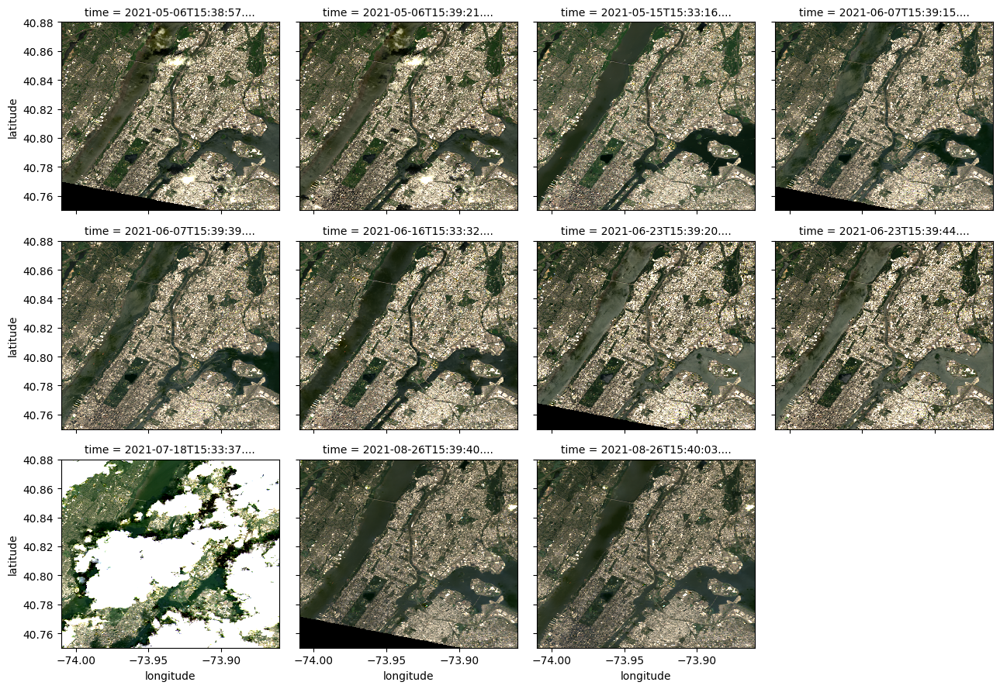

In [149]:
plot_data = data1[["red","green","blue"]].to_array()
plot_data.plot.imshow(col='time', col_wrap=4, robust=True, vmin=0, vmax=0.25)
plt.show()

We chose May 15, 2021 because the weather data was similar to what was experienced on July 24, 2021 from the training data. It was also a clear image for us to use. 

In [150]:
# Pick one of the scenes above (numbering starts with 0)
scene = 2

In [151]:
# Only select one of the time slices to output
data3 = data2.isel(time=scene)

In [152]:
filename = "Landsat_LST_May_15_2021.tiff"

In [153]:
# Calculate the dimensions of the file
height = data3.dims["latitude"]
width = data3.dims["longitude"]

In [154]:
# Define the Coordinate Reference System (CRS) to be common Lat-Lon coordinates
# Define the tranformation using our bounding box so the Lat-Lon information is written to the GeoTIFF
gt = rasterio.transform.from_bounds(lower_left[1],lower_left[0],upper_right[1],upper_right[0],width,height)
data3.rio.write_crs("epsg:4326", inplace=True)
data3.rio.write_transform(transform=gt, inplace=True)

<xarray.Dataset> Size: 19MB
Dimensions:      (latitude: 1448, longitude: 1671)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    time         datetime64[ns] 8B 2021-05-15T15:33:16.857996
    spatial_ref  int64 8B 0
Data variables:
    lwir11       (latitude, longitude) float64 19MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>

In [155]:
# Create the GeoTIFF output file using the defined parameters 
with rasterio.open(filename,'w',driver='GTiff',width=width,height=height,
                   crs='epsg:4326',transform=gt,count=1,compress='lzw',dtype='float64') as dst:
    dst.write(data3.lwir11,1)
    dst.close()

In [156]:
# Only select one of the time slices to output
data4 = data1.isel(time=scene)

In [157]:
filename = "Landsat_LST_bands_May_15_2021.tiff"

In [158]:
# Calculate the dimensions of the file
height = data4.dims["latitude"]
width = data4.dims["longitude"]

In [159]:
# Define the Coordinate Reference System (CRS) to be common Lat-Lon coordinates
# Define the tranformation using our bounding box so the Lat-Lon information is written to the GeoTIFF
gt = rasterio.transform.from_bounds(lower_left[1],lower_left[0],upper_right[1],upper_right[0],width,height)
data4.rio.write_crs("epsg:4326", inplace=True)
data4.rio.write_transform(transform=gt, inplace=True)

<xarray.Dataset> Size: 77MB
Dimensions:      (latitude: 1448, longitude: 1671)
Coordinates:
  * latitude     (latitude) float64 12kB 40.88 40.88 40.88 ... 40.75 40.75 40.75
  * longitude    (longitude) float64 13kB -74.01 -74.01 -74.01 ... -73.86 -73.86
    time         datetime64[ns] 8B 2021-05-15T15:33:16.857996
    spatial_ref  int64 8B 0
Data variables:
    red          (latitude, longitude) float64 19MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>
    green        (latitude, longitude) float64 19MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>
    blue         (latitude, longitude) float64 19MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>
    nir08        (latitude, longitude) float64 19MB dask.array<chunksize=(1448, 1671), meta=np.ndarray>

In [160]:
# Create the GeoTIFF output file using the defined parameters 
with rasterio.open(filename,'w',driver='GTiff',width=width,height=height,
                   crs='epsg:4326',transform=gt,count=4,compress='lzw',dtype='float64') as dst:
    dst.write(data4.red, 1)
    dst.write(data4.green, 2)
    dst.write(data4.blue, 3)
    dst.write(data4.nir08, 4)
    dst.close()

In [161]:
# Open the GeoTIFF file
with rasterio.open('Landsat_LST_May_15_2021.tiff') as src:
    # Read the data
    lst_data = src.read(1)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform

# Function to get the LST value for a given longitude and latitude
def get_lst_value(lon, lat):
    row, col = ~transform * (lon, lat)
    row, col = int(row), int(col)
    # Ensure the indices are within bounds
    if 0 <= row < lst_data.shape[0] and 0 <= col < lst_data.shape[1]:
        return lst_data[row, col]
    else:
        return None

# Add the LST values to the training data
training_data['Thermal'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

# Open the GeoTIFF file
with rasterio.open('Landsat_LST_bands_May_15_2021.tiff') as src:
    # Read the data
    lst_data = src.read(2)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform
# Add the LST values to the training data
training_data['Green'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

# Open the GeoTIFF file
with rasterio.open('Landsat_LST_bands_May_15_2021.tiff') as src:
    # Read the data
    lst_data = src.read(3)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform
# Add the LST values to the training data
training_data['Blue'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

# Open the GeoTIFF file
with rasterio.open('Landsat_LST_bands_May_15_2021.tiff') as src:
    # Read the data
    lst_data = src.read(4)
    # Get the affine transformation of the GeoTIFF
    transform = src.transform
# Add the LST values to the training data
training_data['Near Infared'] = training_data.apply(lambda row: get_lst_value(row['Longitude'], row['Latitude']), axis=1)

In [162]:
training_data.to_csv("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\Landsat_All_Bands_May_15_2021.csv", index=False)

# EDA:

In [163]:
# Load the training data
training_data = pd.read_csv("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\Training_data_uhi_index.csv")

### Showcasing the Bronx vs. Manhattan EY Data:

Initially, we are converting the data to certain datatypes to view correctly.

In [164]:
# Convert 'Date / Time' to datetime
NY_mesonet_weather_bronx['Date / Time'] = pd.to_datetime(NY_mesonet_weather_bronx['Date / Time'])
# Create the hours of the day
NY_mesonet_weather_bronx['Hour'] = NY_mesonet_weather_bronx['Date / Time'].dt.hour
# Convert 'Date / Time' to datetime
NY_mesonet_weather_manhattan['Date / Time'] = pd.to_datetime(NY_mesonet_weather_manhattan['Date / Time'])
# Create the hours of the day
NY_mesonet_weather_manhattan['Hour'] = NY_mesonet_weather_manhattan['Date / Time'].dt.hour
# Combine the bronx and manhattan datasets into one to look at the entire NY data
NY_mesonet_weather = pd.concat([NY_mesonet_weather_bronx, NY_mesonet_weather_manhattan])
NY_mesonet_weather.head()


,Date / Time,Air Temp at Surface [degC],Relative Humidity [percent],Avg Wind Speed [m/s],Wind Direction [degrees],Solar Flux [W/m^2],Hour
0,2021-07-24 06:00:00,19.3,88.2,0.8,335,12,6
1,2021-07-24 06:05:00,19.4,87.9,0.8,329,18,6
2,2021-07-24 06:10:00,19.3,87.6,0.7,321,25,6
3,2021-07-24 06:15:00,19.4,87.4,0.5,307,33,6
4,2021-07-24 06:20:00,19.4,87.0,0.2,301,42,6


Now we are showing the plots of the data related to the different variables.

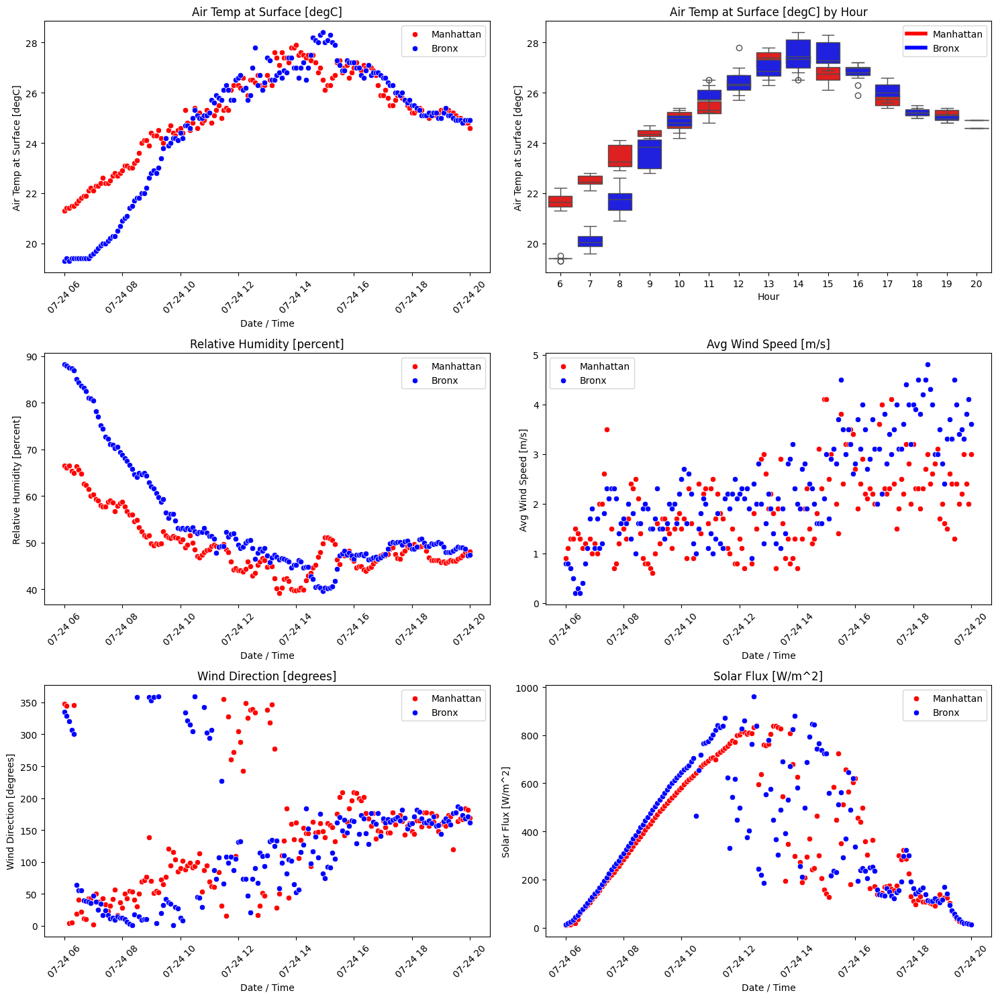

In [165]:
# Create a figure with multiple subplots
fig, axes = plt.subplots(3, 2, figsize=(15, 15))
axes = axes.flatten()

# Scatter plot for Air Temp at Surface
sns.scatterplot(ax=axes[0], x='Date / Time', y='Air Temp at Surface [degC]', data=NY_mesonet_weather_manhattan, color='red')
sns.scatterplot(ax=axes[0], x='Date / Time', y='Air Temp at Surface [degC]', data=NY_mesonet_weather_bronx, color='blue')
axes[0].set_title('Air Temp at Surface [degC]')
axes[0].legend(['Manhattan', 'Bronx'])
axes[0].tick_params(axis='x', rotation=45)

# Box plot for Air Temp at Surface by Hour
sns.boxplot(ax=axes[1], x='Hour', y='Air Temp at Surface [degC]', data=NY_mesonet_weather_manhattan, color='red')
sns.boxplot(ax=axes[1], x='Hour', y='Air Temp at Surface [degC]', data=NY_mesonet_weather_bronx, color='blue')
axes[1].set_title('Air Temp at Surface [degC] by Hour')
axes[1].legend(handles=[plt.Line2D([0], [0], color='red', lw=4, label='Manhattan'),
                        plt.Line2D([0], [0], color='blue', lw=4, label='Bronx')])

# Scatter plot for Relative Humidity
sns.scatterplot(ax=axes[2], x='Date / Time', y='Relative Humidity [percent]', data=NY_mesonet_weather_manhattan, color='red')
sns.scatterplot(ax=axes[2], x='Date / Time', y='Relative Humidity [percent]', data=NY_mesonet_weather_bronx, color='blue')
axes[2].set_title('Relative Humidity [percent]')
axes[2].legend(['Manhattan', 'Bronx'])
axes[2].tick_params(axis='x', rotation=45)

# Scatter plot for Avg Wind Speed
sns.scatterplot(ax=axes[3], x='Date / Time', y='Avg Wind Speed [m/s]', data=NY_mesonet_weather_manhattan, color='red')
sns.scatterplot(ax=axes[3], x='Date / Time', y='Avg Wind Speed [m/s]', data=NY_mesonet_weather_bronx, color='blue')
axes[3].set_title('Avg Wind Speed [m/s]')
axes[3].legend(['Manhattan', 'Bronx'])
axes[3].tick_params(axis='x', rotation=45)

# Scatter plot for Wind Direction
sns.scatterplot(ax=axes[4], x='Date / Time', y='Wind Direction [degrees]', data=NY_mesonet_weather_manhattan, color='red')
sns.scatterplot(ax=axes[4], x='Date / Time', y='Wind Direction [degrees]', data=NY_mesonet_weather_bronx, color='blue')
axes[4].set_title('Wind Direction [degrees]')
axes[4].legend(['Manhattan', 'Bronx'])
axes[4].tick_params(axis='x', rotation=45)

# Scatter plot for Solar Flux
sns.scatterplot(ax=axes[5], x='Date / Time', y='Solar Flux [W/m^2]', data=NY_mesonet_weather_manhattan, color='red')
sns.scatterplot(ax=axes[5], x='Date / Time', y='Solar Flux [W/m^2]', data=NY_mesonet_weather_bronx, color='blue')
axes[5].set_title('Solar Flux [W/m^2]')
axes[5].legend(['Manhattan', 'Bronx'])
axes[5].tick_params(axis='x', rotation=45)

# Adjust layout
plt.tight_layout()
plt.show()

Showcasing the correlation of the data.

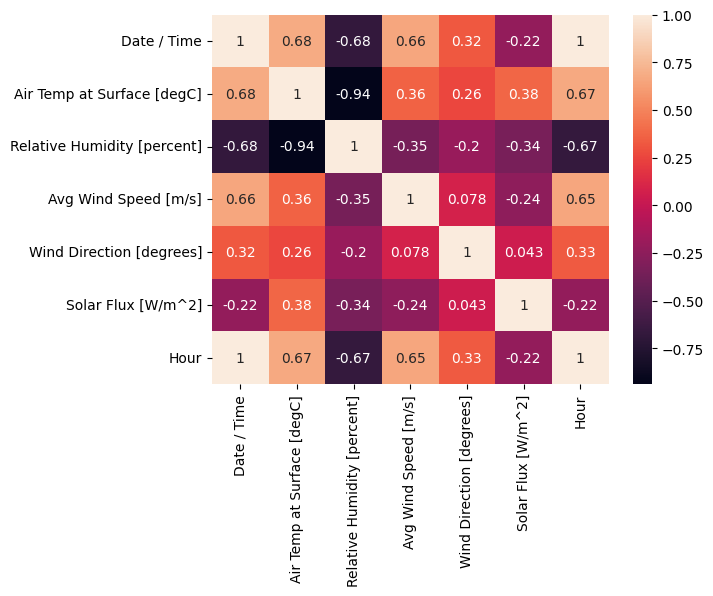

In [166]:
# Make a correlation matrix of the data
corr = NY_mesonet_weather.corr()
sns.heatmap(corr, annot=True)
plt.show()

### Showcasing Elevation Data:

Here are the starting points of the buildings.

In [167]:
# Convert the elevation_2['Elevation'] column to meters instead of feet
elevation['z_grade'] = elevation['z_grade'] * 0.328084
# Convert the_geom to a GeoDataFrame
elevation['geometry'] = elevation['the_geom'].apply(wkt.loads)
gdf_geometry = gpd.GeoDataFrame(elevation, geometry='geometry')

# Filter the elevation data points within the bounding box
filtered_elevation = elevation[
    (elevation['latitude'] >= min_lat) &
    (elevation['latitude'] <= max_lat) &
    (elevation['longitude'] >= min_lon) &
    (elevation['longitude'] <= max_lon)
]

# Display the filtered data
filtered_elevation.head()

,the_geom,bin,bbl,borough,block,lot,address,z_grade,z_floor,subgrade,...,pluto_bbl,Council,BoroCD,CTLabel,BoroCT2020,NTA2020,NTAName,CDTA2020,CDTAName,geometry
25,POINT (-73.93030953755036 40.75433737281967),4004543,4003740018,4.0,374.0,18,32-02 32 STREET,13.840880,43.780,N,...,4003740018,26,401,55.0,4005500,QN0105,Queensbridge-Ravenswood-Dutch Kills,QN01,QN01 Astoria-Queensbridge (CD 1 Equivalent),POINT (-73.93030953755036 40.75433737281967)
26,POINT (-73.9265556011626 40.756115030350735),4009582,4006380012,4.0,638.0,12,35-29 34 STREET,14.684056,48.126,N,...,4006380012,26,401,57.0,4005700,QN0103,Astoria (Central),QN01,QN01 Astoria-Queensbridge (CD 1 Equivalent),POINT (-73.9265556011626 40.756115030350735)
29,POINT (-73.94487656293961 40.809825413524884),1076640,1019120139,1.0,1912.0,139,112 WEST 128 STREET,8.923229,27.509,N,...,1019120139,9,110,224.0,1022400,MN1002,Harlem (North),MN10,MN10 Harlem (CD 10 Equivalent),POINT (-73.94487656293961 40.809825413524884)
30,POINT (-73.94119794139434 40.808670564065395),1089812,1017260132,1.0,1726.0,132,3 WEST 128 STREET,7.995735,24.867,N,...,1017260132,9,110,208.0,1020800,MN1002,Harlem (North),MN10,MN10 Harlem (CD 10 Equivalent),POINT (-73.94119794139434 40.808670564065395)
33,POINT (-73.91190559445964 40.82251364884388),2113740,2023817501,2.0,2381.0,56,NaN,9.902231,30.811,N,...,2023817501,17,203,141.0,2014100,BX0301,Morrisania,BX03,BX03 Morrisania-Crotona Park East (CD 3 Approx...,POINT (-73.91190559445964 40.82251364884388)


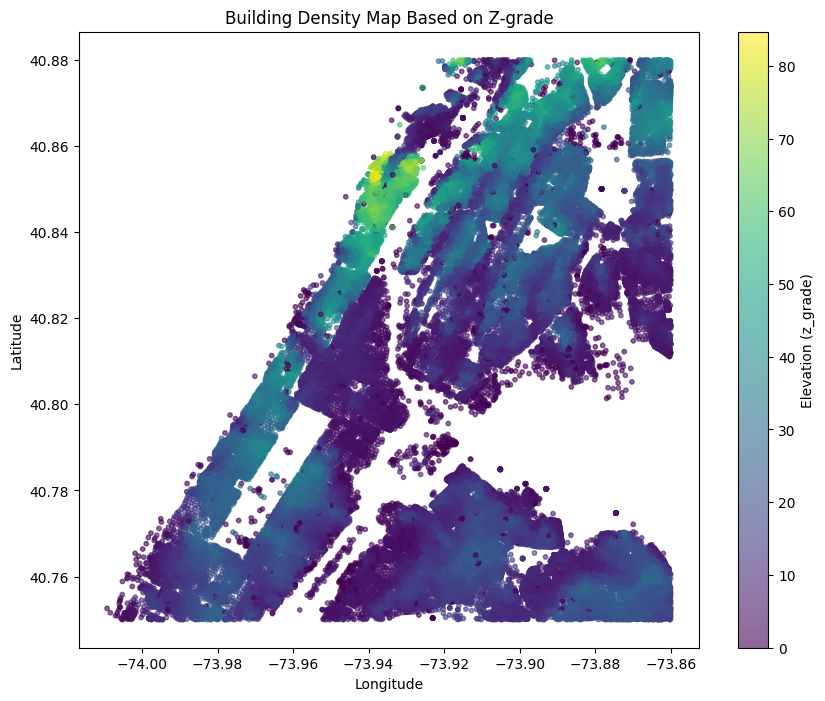

In [168]:
# Extract the longitude, latitude, and z_grade columns
longitude = filtered_elevation['longitude']
latitude = filtered_elevation['latitude']
z_grade = filtered_elevation['z_grade']

# Create a scatter plot with a color map based on z_grade
plt.figure(figsize=(10, 8))
plt.scatter(longitude, latitude, c=z_grade, cmap='viridis', s=10, alpha=0.6)
plt.colorbar(label='Elevation (z_grade)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Building Density Map Based on Z-grade')
plt.show()

Here are the values for the actual elevation:

In [169]:
# Convert the_geom to a GeoDataFrame
elevation_2['geometry'] = elevation_2['the_geom'].apply(wkt.loads)
gdf_geometry = gpd.GeoDataFrame(elevation_2, geometry='geometry')

# Filter the elevation_2 data points within the bounding box
filtered_elevation_2 = elevation_2[
    (elevation_2['geometry'].apply(lambda geom: geom.y) >= min_lat) &
    (elevation_2['geometry'].apply(lambda geom: geom.y) <= max_lat) &
    (elevation_2['geometry'].apply(lambda geom: geom.x) >= min_lon) &
    (elevation_2['geometry'].apply(lambda geom: geom.x) <= max_lon)
]

# Display the filtered data
filtered_elevation_2

,the_geom,FEAT_CODE,ELEVATION,SOURCE_ID,SUB_CODE,STATUS,geometry
165238,POINT (-73.8626183051479 40.756719873124595),3000,67.449300,9300071219,300000,Unchanged,POINT (-73.8626183051479 40.756719873124595)
165245,POINT (-73.8705356421596 40.75677129042423),3020,129.418414,9302079783,302000,Unchanged,POINT (-73.8705356421596 40.75677129042423)
165253,POINT (-73.86079825075535 40.7567283735753),3000,62.712533,11300000164,300000,Unchanged,POINT (-73.86079825075535 40.7567283735753)
165263,POINT (-73.86005876605635 40.75673998474767),3020,68.500000,11302000174,302000,Unchanged,POINT (-73.86005876605635 40.75673998474767)
165279,POINT (-73.86150760211845 40.75675342876783),3020,107.820000,11302000190,302000,Unchanged,POINT (-73.86150760211845 40.75675342876783)
...,...,...,...,...,...,...,...
1463176,POINT (-73.87310745275488 40.7740076273949),3020,54.955273,10302066892,302000,New,POINT (-73.87310745275488 40.7740076273949)
1463177,POINT (-73.94920107961813 40.753868900805145),3020,17.115440,0,302000,New,POINT (-73.94920107961813 40.753868900805145)
1463178,POINT (-73.86302674465158 40.751567925884544),3020,67.022922,0,302000,New,POINT (-73.86302674465158 40.751567925884544)
1463179,POINT (-73.8766483066541 40.752067811643904),3020,87.151161,0,302000,New,POINT (-73.8766483066541 40.752067811643904)


In [170]:
# Convert the elevation_2['Elevation'] column to meters instead of feet
filtered_elevation_2['ELEVATION'] = filtered_elevation_2['ELEVATION'] * 0.328084
# Extract coordinates from filtered_elevation and filtered_elevation_2_building
coords_elevation = np.array(list(zip(filtered_elevation['longitude'], filtered_elevation['latitude'])))
coords_elevation_2 = np.array(list(zip(filtered_elevation_2['geometry'].apply(lambda geom: geom.x), filtered_elevation_2['geometry'].apply(lambda geom: geom.y))))

# Create a KDTree for filtered_elevation_2_building
tree_elevation_2 = cKDTree(coords_elevation_2)

# Query the KDTree to find the nearest neighbors in filtered_elevation_2_building for each point in filtered_elevation
distances, indices = tree_elevation_2.query(coords_elevation, k=1)

# Compute the difference in elevation
elevation_difference = filtered_elevation_2.iloc[indices]['ELEVATION'].values - filtered_elevation['z_grade'].values

# Create a new dataframe with the required columns
elevation_df = pd.DataFrame({
    'longitude': filtered_elevation['longitude'],
    'latitude': filtered_elevation['latitude'],
    'z_grade': filtered_elevation['z_grade'],
    'Total Elevation': filtered_elevation_2['ELEVATION'].values[indices],
    'Actual Elevation': elevation_difference,
    'Feat_Code': filtered_elevation_2.iloc[indices]['FEAT_CODE'].values
})

# Display the new dataframe
elevation_df.head()

,longitude,latitude,z_grade,Total Elevation,Actual Elevation,Feat_Code
25,-73.930310,40.754337,13.840880,25.827324,11.986444,3020
26,-73.926556,40.756115,14.684056,24.318522,9.634467,3020
29,-73.944877,40.809825,8.923229,22.087472,13.164243,3020
30,-73.941198,40.808671,7.995735,28.066493,20.070757,3020
33,-73.911906,40.822514,9.902231,43.235523,33.333292,3020


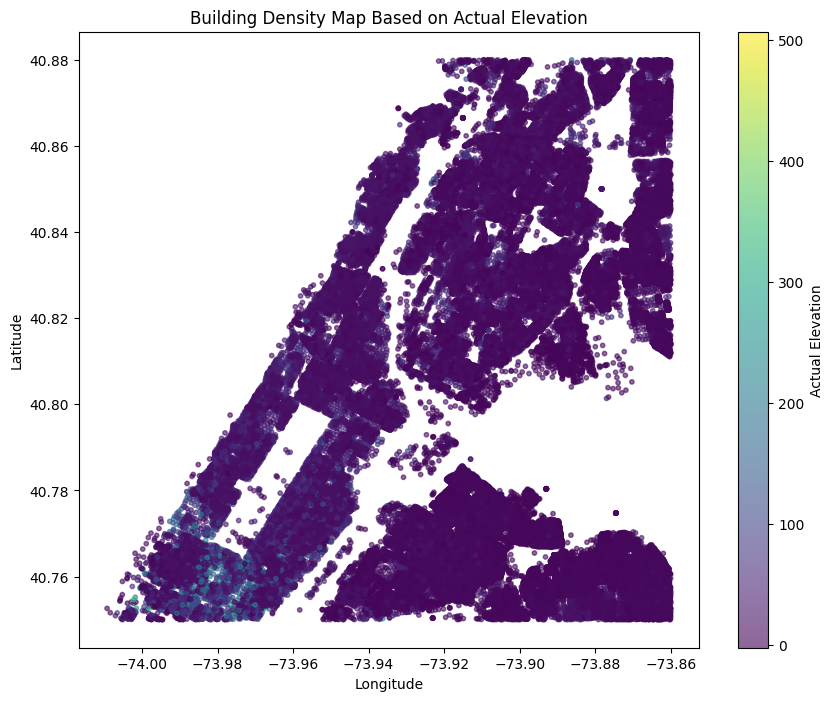

In [171]:
elevation_df_building = elevation_df[elevation_df['Feat_Code'] == 3020]
# Extract the longitude, latitude, and Actual Elevation columns
longitude = elevation_df_building['longitude']
latitude = elevation_df_building['latitude']
actual_elevation = elevation_df_building['Actual Elevation']

# Create a scatter plot with a color map based on Actual Elevation
plt.figure(figsize=(10, 8))
plt.scatter(longitude, latitude, c=actual_elevation, cmap='viridis', s=10, alpha=0.6)
plt.colorbar(label='Actual Elevation')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Building Density Map Based on Actual Elevation')
plt.show()

# Model Development:

In [ ]:
# Load in the data
all_elevation_nyc = pd.read_csv("C:\\Users\\jrzem\OneDrive\\Desktop\\EY Dataset\\Elevation\\all_elevation_nyc.csv")
landsat_all_bands = pd.read_csv("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\Landsat_All_Bands_May_15_2021.csv")
noisy_5_bands_proxmity = pd.read_csv("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\Satellite Data\\5_noisy_all_bands_proximity.csv")
sentinel_1_bands = pd.read_csv("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\Sentinel_1_All_Bands_July_26_2021.csv")

In [173]:
landsat_all_bands = pd.read_csv("C:\\Users\\jrzem\\OneDrive\\Desktop\\EY Dataset\\Landsat_All_Bands_May_15_2021.csv")

In [174]:
landsat_all_bands_elevation = landsat_all_bands.merge(all_elevation_nyc[['Longitude', 'Latitude', 'Building Height Only Proximity','Natural Proximity']], on=['Longitude', 'Latitude'])
landsat_sentinel_elevation = landsat_all_bands_elevation.merge(noisy_5_bands_proxmity[['Longitude', 'Latitude', 'BO1',
       'BO2', 'BO3', 'BO4', 'BO5', 'BO6', 'BO7', 'BO8', 'B8A', 'B11', 'B12']], on=['Longitude', 'Latitude'])
landsat_sentinel_1_and_2_elevation = landsat_sentinel_elevation.merge(sentinel_1_bands[['Longitude', 'Latitude','vv','vh']], on=['Longitude', 'Latitude'])
landsat_sentinel_1_and_2_elevation

,Longitude,Latitude,datetime,UHI Index,Thermal,Green,Blue,Near Infared,Building Height Only Proximity,Natural Proximity,...,BO4,BO5,BO6,BO7,BO8,B8A,B11,B12,vv,vh
0,-73.909167,40.813107,24-07-2021 15:53,1.030289,34.032548,0.108165,0.096092,0.170425,31.625333,34.799111,...,936.0,1212.0,1783.0,2042.0,2075.0,2186.0,1617.5,1305.5,396.0,199.0
1,-73.909187,40.813045,24-07-2021 15:53,1.030289,34.032548,0.108165,0.096092,0.170425,31.625333,34.799111,...,936.0,1212.0,1783.0,2042.0,2075.0,2186.0,1617.5,1305.5,396.0,199.0
2,-73.909215,40.812978,24-07-2021 15:53,1.023798,29.489999,0.139487,0.115260,0.137288,31.625333,34.799111,...,936.0,1212.0,1783.0,2042.0,2075.0,2186.0,1617.5,1305.5,661.0,177.0
3,-73.909242,40.812908,24-07-2021 15:53,1.023798,29.489999,0.139487,0.115260,0.137288,31.625333,34.799111,...,936.0,1212.0,1783.0,2042.0,2075.0,2186.0,1617.5,1305.5,661.0,177.0
4,-73.909257,40.812845,24-07-2021 15:53,1.021634,29.489999,0.139487,0.115260,0.137288,31.625333,34.799111,...,936.0,1212.0,1783.0,2042.0,2075.0,2186.0,1617.5,1305.5,421.0,185.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11224,-73.957050,40.790333,24-07-2021 15:57,0.972470,40.253344,0.125738,0.111520,0.150982,119.102000,65.588000,...,501.0,999.0,2612.0,3111.5,3179.5,3446.5,1925.0,1072.5,136.0,105.0
11225,-73.957063,40.790308,24-07-2021 15:57,0.972470,40.253344,0.125738,0.111520,0.150982,119.102000,65.588000,...,501.0,999.0,2612.0,3111.5,3179.5,3446.5,1925.0,1072.5,136.0,105.0
11226,-73.957093,40.790270,24-07-2021 15:57,0.981124,40.253344,0.125738,0.111520,0.150982,119.102000,65.588000,...,501.0,999.0,2612.0,3111.5,3179.5,3446.5,1925.0,1072.5,136.0,105.0
11227,-73.957112,40.790253,24-07-2021 15:59,0.981245,40.253344,0.125738,0.111520,0.150982,119.102000,65.588000,...,501.0,999.0,2612.0,3111.5,3179.5,3446.5,1925.0,1072.5,136.0,105.0


# Model:

### Standardizing Values and Splitting:

We removed some less important features.

In [175]:
# Load dataset
df = landsat_sentinel_1_and_2_elevation.copy()

# Define spectral features
spectral_features = ['Thermal','Near Infared', 'Building Height Only Proximity','Natural Proximity','BO1',
       'BO2', 'BO3', 'BO4', 'BO5', 'BO6', 'BO7', 'BO8', 'B8A', 'B11', 'B12','vv','vh']

# Select features and target
X = df[spectral_features]
y = df['UHI Index']

# Train-test split (80-20)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardization (Not necessary for Random Forest but kept for consistency)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

### Training Model:

In [176]:
# Initialize and train Random Forest Regressor
rf_model = RandomForestRegressor(n_estimators=100, random_state=42, n_jobs=-1)
rf_model.fit(X_train_scaled, y_train)

# Evaluate model performance
y_pred = rf_model.predict(X_test_scaled)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

print(f"Model Performance:\n - MAE: {mae:.4f}\n - RMSE: {rmse:.4f}")

Model Performance:
 - MAE: 0.0027
 - RMSE: 0.0039


### Hyperparameter Tuning:

In [177]:
# Define a narrower, more focused parameter grid
param_dist = {
    'n_estimators': [100, 200, 300, 400, 500],           # Added more options for number of trees
    'max_depth': [10, 20, 30, None],                     # Added 30 back for more depth options
    'min_samples_split': [2, 5, 10],                     # Added 10 for more split options
    'min_samples_leaf': [1, 2, 4],                       # Added 4 for more leaf options
    'max_features': ['auto', 'sqrt', 'log2'],            # Added 'log2' for more feature sampling options
    'bootstrap': [True, False]                           # Added False to consider both bootstrapping options
}

# Initialize Random Forest Regressor with OOB enabled upfront
rf = RandomForestRegressor(random_state=42, n_jobs=-1, oob_score=True)

# Perform Randomized Search with efficiency tweaks
random_search = RandomizedSearchCV(
    estimator=rf, 
    param_distributions=param_dist,
    n_iter=100,                                # Increased iterations for more thorough search
    cv=3,                                      # Kept at 3 for balance
    scoring='neg_mean_absolute_error', 
    verbose=1,                                 # Reduced verbosity for speed
    random_state=42, 
    n_jobs=-1,                                 # Parallel processing
    return_train_score=False                   # Avoid unnecessary computation
)

# Fit the model (assuming X_train_scaled and y_train are defined)
random_search.fit(X_train_scaled, y_train)

# Get the best model
best_rf_model = random_search.best_estimator_

# No need to refit with OOB since it’s already enabled
# Evaluate model on the test set (assuming X_test_scaled and y_test are defined)
y_pred = best_rf_model.predict(X_test_scaled)
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

# Print evaluation results
print(f"Best Hyperparameters: {random_search.best_params_}")
print(f"Optimized Model Performance:\n - MAE: {mae:.4f}\n - RMSE: {rmse:.4f}")
print(f"OOB Score: {best_rf_model.oob_score_:.4f}")

Fitting 3 folds for each of 100 candidates, totalling 300 fits
Best Hyperparameters: {'n_estimators': 400, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': None, 'bootstrap': True}
Optimized Model Performance:
 - MAE: 0.0026
 - RMSE: 0.0038
OOB Score: 0.9455


### Making the Test Data Predictions:

In [178]:
def add_nearest_data(uhi_data: pd.DataFrame, data_to_map: pd.DataFrame) -> pd.DataFrame:
    """
    Adds nearest spectral data to submission dataset using KDTree.

    Parameters:
        uhi_data (pd.DataFrame): DataFrame containing submission locations (Latitude, Longitude).
        data_to_map (pd.DataFrame): DataFrame containing spectral band values.

    Returns:
        pd.DataFrame: Submission dataset with matched spectral data.
    """
    # Extract coordinates
    elevation_coords = np.array(list(zip(data_to_map["Latitude"], data_to_map["Longitude"])))
    uhi_coords = np.array(list(zip(uhi_data["Latitude"], uhi_data["Longitude"])))
    
    # Build KDTree
    tree = cKDTree(elevation_coords)
    
    # Find nearest neighbors
    _, indices = tree.query(uhi_coords)
    
    # Add matched spectral data
    uhi_data = uhi_data.copy()
    for col in spectral_features:
        uhi_data[col] = data_to_map.iloc[indices][col].values
    
    return uhi_data

# Match spectral features for submission data
submission_all_bands_elevation = add_nearest_data(test_data, landsat_sentinel_1_and_2_elevation)

In [179]:
# Prepare submission data for prediction
x_submission_test = submission_all_bands_elevation[spectral_features]

# Standardize submission data using the same scaler
x_submission_test_scaled = scaler.transform(x_submission_test)

# Make predictions
submission_predictions = best_rf_model.predict(x_submission_test_scaled)

# Add predictions to submission DataFrame
submission_all_bands_elevation["UHI Index"] = submission_predictions

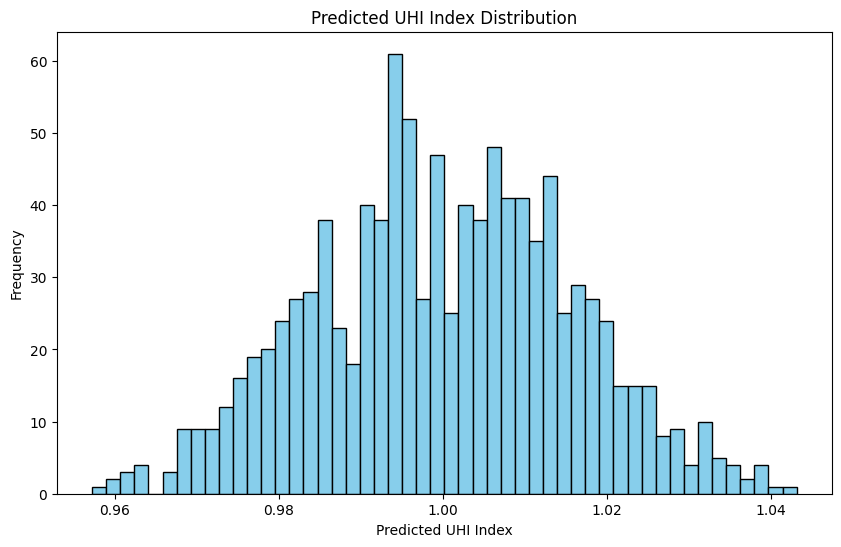

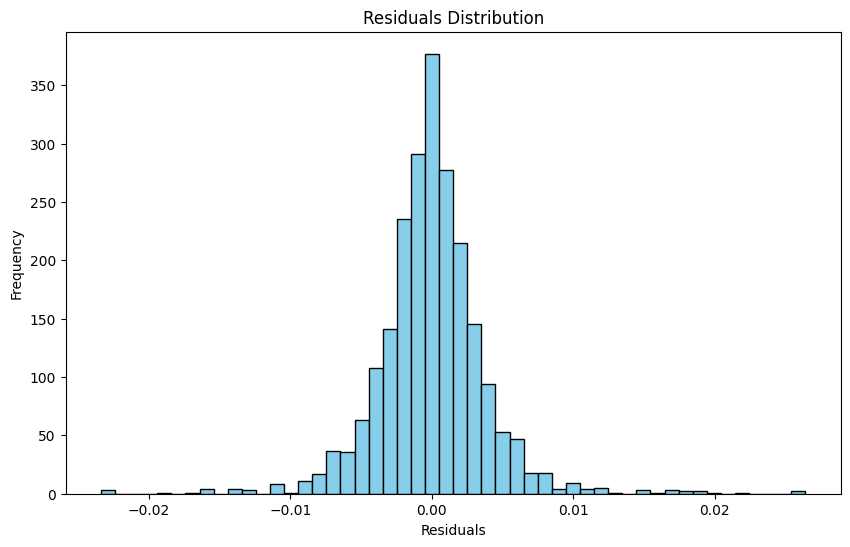

In [180]:
# Plot predictions
plt.figure(figsize=(10, 6))
plt.hist(submission_predictions, bins=50, color='skyblue', edgecolor='black')
plt.xlabel('Predicted UHI Index')
plt.ylabel('Frequency')
plt.title('Predicted UHI Index Distribution')
plt.show()

# Plot Residuals
plt.figure(figsize=(10, 6))
plt.hist(y_test - y_pred, bins=50, color='skyblue', edgecolor='black')
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.title('Residuals Distribution')
plt.show()

### Feature Importance:

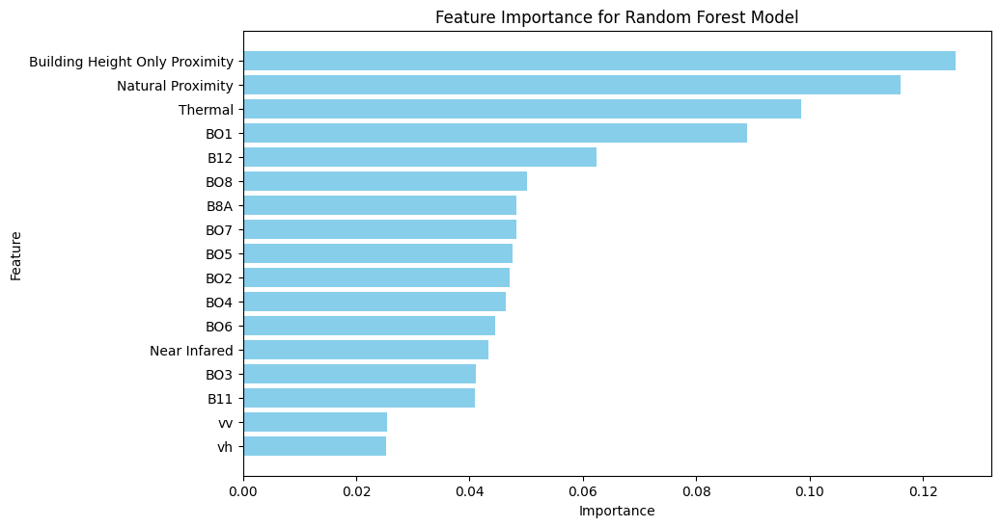

In [181]:
# Get feature importances
importances = best_rf_model.feature_importances_

# Create a DataFrame for better visualization
feature_importance_df = pd.DataFrame({
    'Feature': spectral_features,
    'Importance': importances
})

# Sort the DataFrame by importance
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Plot feature importances
plt.figure(figsize=(10, 6))
plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'], color='skyblue')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importance for Random Forest Model')
plt.gca().invert_yaxis()
plt.show()

### Submission Data:

In [182]:
# Load the final submission
submission_all_bands_elevation_final = submission_all_bands_elevation[['Longitude', 'Latitude', 'UHI Index']]
submission_all_bands_elevation_final.to_csv("C:\\Users\\jrzem\\Downloads\\submission_all_bands_elevation.csv", index=False)

This got a 0.9606 accuracy.

# Conclusion:

### Implications:

We can understand that the key indicators of urban heat detection relate to the height of buildings and other areas, thermal detection, and many color detection bands from the satellites.

### Future Thoughts:

We can assess sea surface temperature imapcts. 